In [ ]:
import os
from IPython.display import display, Image
import random
import numpy as np
import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report
from tensorflow.keras import layers, models
import pandas as pd
import matplotlib.pyplot as plt
from tensorflow.keras.preprocessing.image import load_img, img_to_array

LOAD DATA


In [ ]:
data=tf.keras.utils.image_dataset_from_directory('./All_images/training')

In [85]:
train_data_dir = './All_images/training'

# Set the desired image size (e.g., 128x128)
desired_image_size = (256, 256)

# Use image_dataset_from_directory to create a labeled dataset
data = tf.keras.utils.image_dataset_from_directory(
    train_data_dir,
    batch_size=32,               # Adjust batch size as needed
    image_size=desired_image_size,  # Specify the desired image size
    shuffle=True,                # Shuffle the dataset
    seed=123                     # Set seed for reproducibility
)

Found 1301 files belonging to 2 classes.


In [86]:
data

<_BatchDataset element_spec=(TensorSpec(shape=(None, 256, 256, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None,), dtype=tf.int32, name=None))>

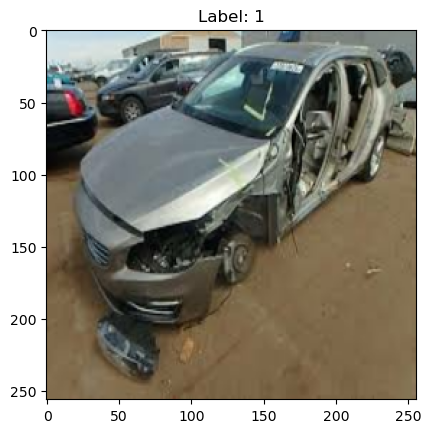

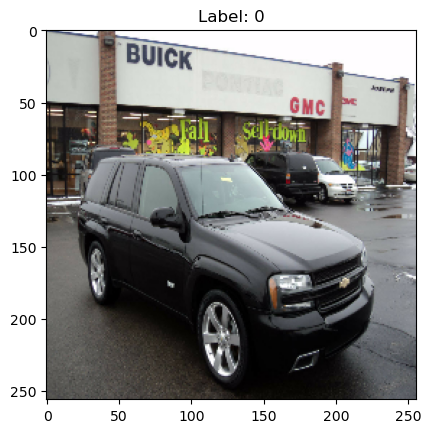

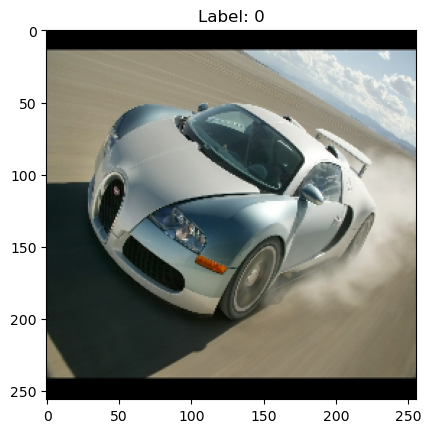

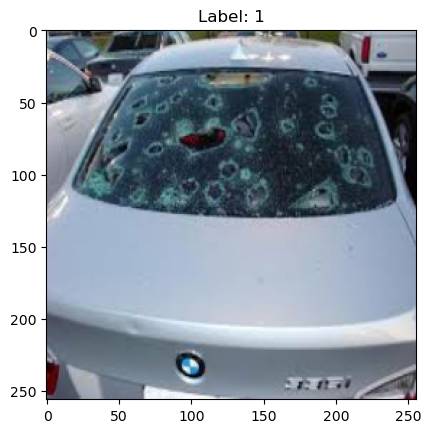

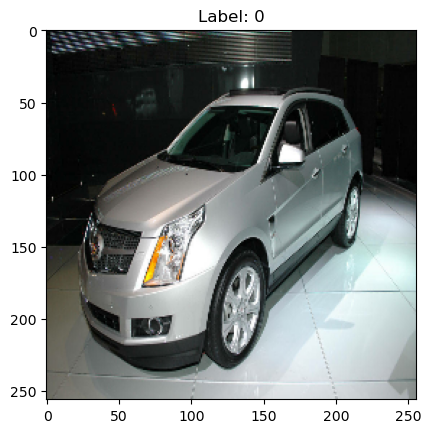

...

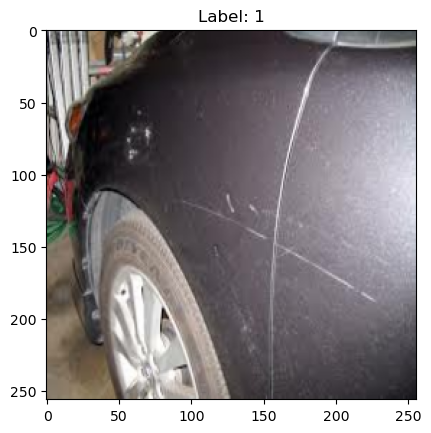

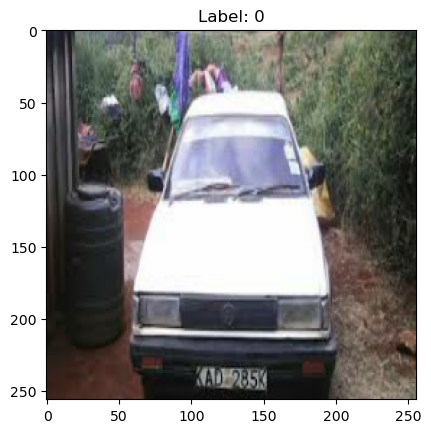

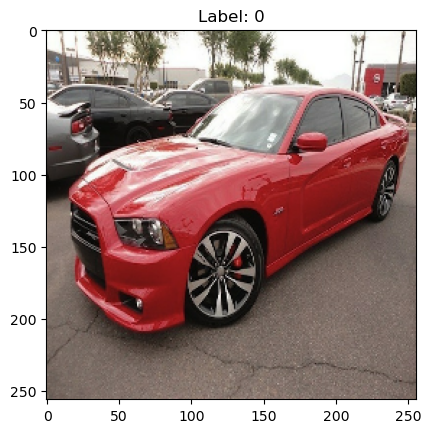

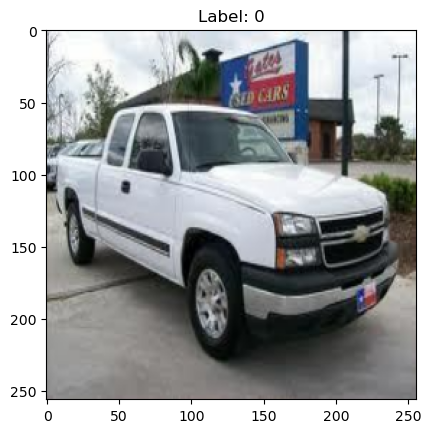

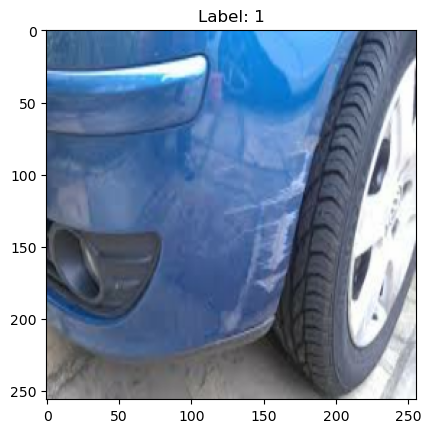

In [87]:
# for element in data:
#     images, labels = element
#     for i in range(len(images)):
#         # Assuming you are using matplotlib to display images
#         plt.imshow(images[i].numpy().astype("uint8"))
#         plt.title(f"Label: {labels[i].numpy()}")
#         plt.show()

# Counter to keep track of the number of images printed
# Define a dictionary to keep track of the number of images shown for each class
num_images_shown_per_class = {}

# Iterate through the dataset and print only the first 10 images from each class
for images, labels in data:
    for i in range(len(images)):
        label = labels[i].numpy()
        
        # Check if the current label exists in the dictionary
        if label not in num_images_shown_per_class:
            num_images_shown_per_class[label] = 0
        
        # Display the image using matplotlib if fewer than 10 images have been shown for this class
        if num_images_shown_per_class[label] < 10:
            plt.imshow(images[i].numpy().astype("uint8"))
            plt.title(f"Label: {label}")
            plt.show()
            
            # Increment the counter for the current class
            num_images_shown_per_class[label] += 1
            
        # Check if 10 images have been shown for each class
        if all(count >= 10 for count in num_images_shown_per_class.values()):
            break
            
    # Check if 10 images have been shown for each class
    if all(count >= 10 for count in num_images_shown_per_class.values()):
        break



In [88]:
   #  print(f"Type of element: {type(element)}")
print(f"Type of images: {type(images)}")
print(f"Type of labels: {type(labels)}")

Type of images: <class 'tensorflow.python.framework.ops.EagerTensor'>
Type of labels: <class 'tensorflow.python.framework.ops.EagerTensor'>


In [89]:
# Check the size of the images
image_size = data.element_spec[0].shape[1:3]
print("Image size:", image_size)

Image size: (256, 256)


In [90]:
data_iterator=data.as_numpy_iterator()
batch=data_iterator.next()
#image representative as numpy array
print(len(batch))
batch[0].shape
batch[1]

2


array([0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1,
       0, 1, 0, 0, 0, 0, 0, 0, 0, 0])

In [91]:
batch_size = batch[0].shape[0]
print("Batch size:", batch_size)

Batch size: 32


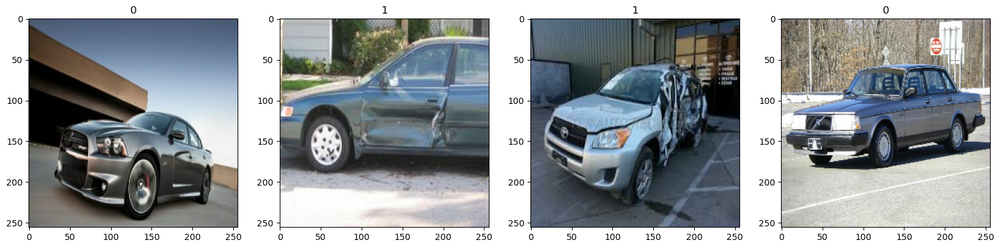

In [92]:
fig,ax=plt.subplots(ncols=4,figsize=(20,20))
for idx,img in enumerate(batch[0][:4]):
    ax[idx].imshow(img.astype(int))
    ax[idx].title.set_text(batch[1][idx])

Pre_Process Data

In [93]:
data=data.map(lambda x,y: (x/255 ,y))

In [94]:
data.as_numpy_iterator().next()

(array([[[[0.41470587, 0.45392156, 0.4107843 ],
          [0.39509803, 0.4343137 , 0.39117646],
          [0.43137255, 0.47058824, 0.42745098],
          ...,
          [0.32132354, 0.3615196 , 0.33210784],
          [0.28308824, 0.32916668, 0.3115196 ],
          [0.24485295, 0.29191175, 0.27622548]],
 
         [[0.41470587, 0.45392156, 0.4107843 ],
          [0.39509803, 0.4343137 , 0.39117646],
          [0.43137255, 0.47058824, 0.42745098],
          ...,
          [0.33694854, 0.3771446 , 0.34773284],
          [0.3007353 , 0.34681374, 0.32916668],
          [0.2625    , 0.3095588 , 0.29387254]],
 
         [[0.41470587, 0.45392156, 0.4107843 ],
          [0.39509803, 0.4343137 , 0.39117646],
          [0.43137255, 0.47058824, 0.42745098],
          ...,
          [0.36102942, 0.40122548, 0.3718137 ],
          [0.3227941 , 0.36887255, 0.3512255 ],
          [0.28529412, 0.33235294, 0.31666666]],
 
         ...,
 
         [[0.29203433, 0.29987746, 0.24889706],
          [0.27977

In [95]:
len(data) #represent batch size

41

In [96]:
train_size=int(len(data)*.7)-1
val_size=int(len(data)*.2)+1
test_size=int(len(data)*.1)+1

In [97]:
print(train_size,val_size,test_size)

27 9 5


In [98]:
train=data.take(train_size)
val=data.skip(train_size).take(val_size)
test=data.skip(train_size+val_size).take(test_size)

In [111]:
# #Assuming 4 classes (adjust as needed)
# num_classes = 5

# # Image size
# img_height, img_width = 256, 256

# model = models.Sequential([
#     layers.Conv2D(32, (3, 3), activation='relu', input_shape=(img_height, img_width, 3)),
#     layers.MaxPooling2D((2, 2)),
#     layers.Conv2D(64, (3, 3), activation='relu'),
#     layers.MaxPooling2D((2, 2)),
#     layers.Conv2D(128, (3, 3), activation='relu'),
#     layers.MaxPooling2D((2, 2)),
#     layers.Flatten(),
#     layers.Dense(256, activation='relu'),
#     layers.Dense(num_classes, activation='softmax')  # Multi-class classification, so using softmax activation
# ])
#Assuming 4 classes (adjust as needed)
num_classes = 2

# Image size
img_height, img_width = 256, 256

model = models.Sequential([
    layers.Conv2D(32, (3, 3), activation='relu', input_shape=(img_height, img_width, 3)),
    layers.MaxPooling2D((2, 2)),
    layers.Conv2D(64, (3, 3), activation='relu'),
    layers.MaxPooling2D((2, 2)),
    layers.Conv2D(128, (3, 3), activation='relu'),
    layers.MaxPooling2D((2, 2)),
    layers.Flatten(),
    layers.Dense(256, activation='relu'),
    layers.Dense(num_classes, activation='softmax')  # Multi-class classification, so using sigmoid activation
])

In [112]:
model.summary()

Model: "sequential_5"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_15 (Conv2D)          (None, 254, 254, 32)      896       
                                                                 
 max_pooling2d_15 (MaxPooli  (None, 127, 127, 32)      0         
 ng2D)                                                           
                                                                 
 conv2d_16 (Conv2D)          (None, 125, 125, 64)      18496     
                                                                 
 max_pooling2d_16 (MaxPooli  (None, 62, 62, 64)        0         
 ng2D)                                                           
                                                                 
 conv2d_17 (Conv2D)          (None, 60, 60, 128)       73856     
                                                                 
 max_pooling2d_17 (MaxPooli  (None, 30, 30, 128)      

In [113]:
# Compile the model
model.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])
# model.compile(optimizer='adam',
#               loss='binary_crossentropy',  # Use binary crossentropy for binary classification
#               metrics=['accuracy'])

TRAin model


In [114]:
logsdir='.\logs'

In [115]:
tensorboard_callback=tf.keras.callbacks.TensorBoard(log_dir=logsdir)

In [116]:
hist=model.fit(train,epochs=5,validation_data=val,callbacks=[tensorboard_callback])

Epoch 1/5


27/27 [==============================] - 106s 4s/step - loss: 1.1713 - accuracy: 0.6157 - val_loss: 0.5262 - val_accuracy: 0.7257
Epoch 2/5
27/27 [==============================] - 106s 4s/step - loss: 0.5080 - accuracy: 0.7477 - val_loss: 0.4681 - val_accuracy: 0.7917
Epoch 3/5
27/27 [==============================] - 104s 4s/step - loss: 0.3626 - accuracy: 0.8333 - val_loss: 0.4078 - val_accuracy: 0.8264
Epoch 4/5
27/27 [==============================] - 94s 3s/step - loss: 0.2449 - accuracy: 0.8935 - val_loss: 0.3538 - val_accuracy: 0.8438
Epoch 5/5
27/27 [==============================] - 105s 4s/step - loss: 0.1356 - accuracy: 0.9549 - val_loss: 0.3904 - val_accuracy: 0.8681


In [117]:
hist.history

{'loss': [1.1713019609451294,
  0.5079916715621948,
  0.36264175176620483,
  0.24485981464385986,
  0.13564693927764893],
 'accuracy': [0.6157407164573669,
  0.7476851940155029,
  0.8333333134651184,
  0.8935185074806213,
  0.9548611044883728],
 'val_loss': [0.5262467265129089,
  0.4681206941604614,
  0.4077558219432831,
  0.35383713245391846,
  0.3904435336589813],
 'val_accuracy': [0.7256944179534912,
  0.7916666865348816,
  0.8263888955116272,
  0.84375,
  0.8680555820465088]}

PLOT Performance

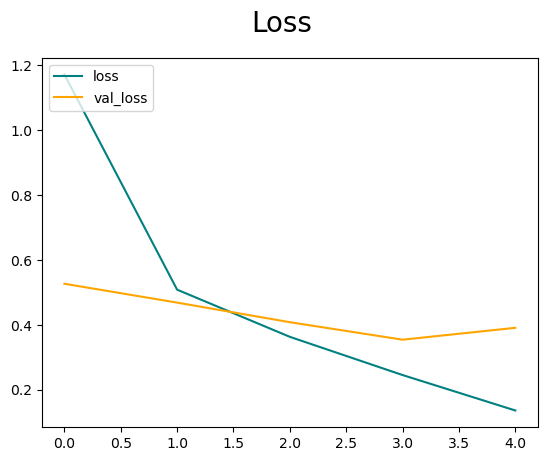

In [118]:
fig=plt.figure()
plt.plot(hist.history['loss'],color='teal',label='loss')
plt.plot(hist.history['val_loss'],color='orange',label='val_loss')
fig.suptitle('Loss',fontsize=20)
plt.legend(loc="upper left")
plt.show()

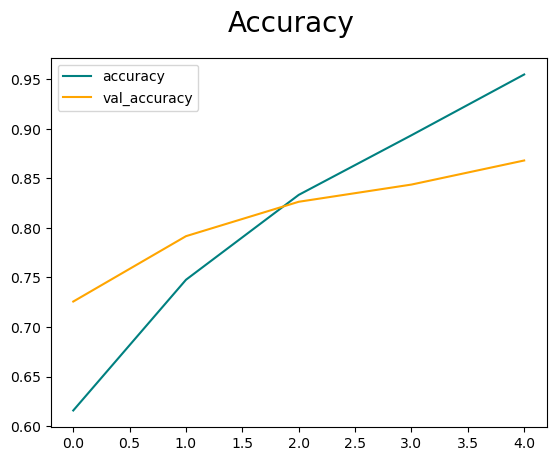

In [119]:
fig=plt.figure()
plt.plot(hist.history['accuracy'],color='teal',label='accuracy')
plt.plot(hist.history['val_accuracy'],color='orange',label='val_accuracy')
fig.suptitle('Accuracy',fontsize=20)
plt.legend(loc="upper left")
plt.show()

Evaluate Performance


In [120]:
from tensorflow.keras.metrics import Precision,Recall,SparseCategoricalAccuracy,CategoricalAccuracy

In [121]:
pre=Precision()
re=Recall()
acc=CategoricalAccuracy()

In [122]:
pre.reset_states()
re.reset_states()
acc.reset_states()

for batch in test.as_numpy_iterator():
    X, y = batch
    yhat = model.predict(X)
    print(y.shape)
    # Get predicted classes
    yhat_classes = np.argmax(yhat, axis=1)
    
    for actual, predicted in zip(y, yhat_classes):
        print(f"Actual: {actual}, Predicted: {predicted}")
    # Assuming 'pre', 're', 'acc' are instances of metrics classes
    pre.update_state(y, yhat_classes)
    re.update_state(y, yhat_classes)
    acc.update_state(y, yhat_classes)


1/1 [==============================] - 1s 1s/step
(32,)
Actual: 1, Predicted: 1
Actual: 1, Predicted: 1
Actual: 0, Predicted: 1
Actual: 0, Predicted: 0
Actual: 1, Predicted: 1
Actual: 1, Predicted: 1
Actual: 1, Predicted: 1
Actual: 0, Predicted: 0
Actual: 1, Predicted: 1
Actual: 1, Predicted: 1
Actual: 1, Predicted: 1
Actual: 0, Predicted: 0
Actual: 1, Predicted: 1
Actual: 1, Predicted: 1
Actual: 0, Predicted: 0
Actual: 0, Predicted: 0
Actual: 1, Predicted: 1
Actual: 1, Predicted: 1
Actual: 0, Predicted: 0
Actual: 1, Predicted: 1
Actual: 1, Predicted: 1
Actual: 0, Predicted: 0
Actual: 0, Predicted: 0
Actual: 0, Predicted: 0
Actual: 1, Predicted: 1
Actual: 1, Predicted: 1
Actual: 0, Predicted: 0
Actual: 0, Predicted: 0
Actual: 1, Predicted: 1
Actual: 1, Predicted: 1
Actual: 1, Predicted: 1
Actual: 0, Predicted: 0
1/1 [==============================] - 1s 918ms/step
(32,)
Actual: 0, Predicted: 1
Actual: 0, Predicted: 0
Actual: 0, Predicted: 0
Actual: 0, Predicted: 0
Actual: 0, Predicted:

1/1 [==============================] - 1s 718ms/step
Actual: 1, Predicted: 1


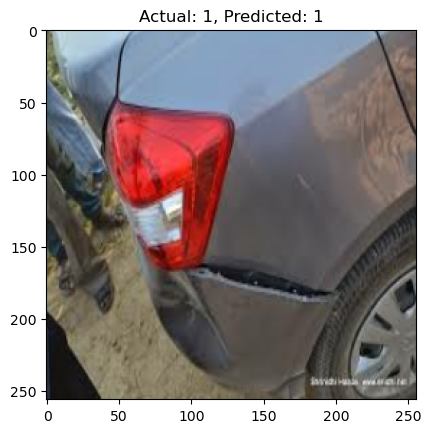

Actual: 1, Predicted: 1


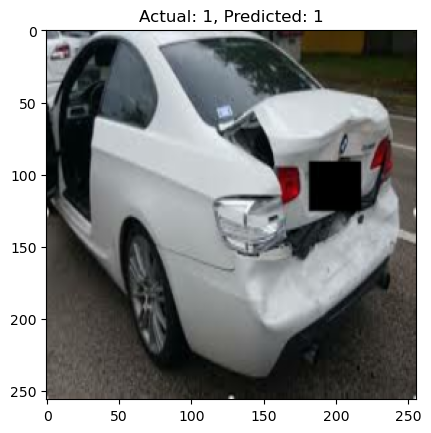

Actual: 1, Predicted: 1


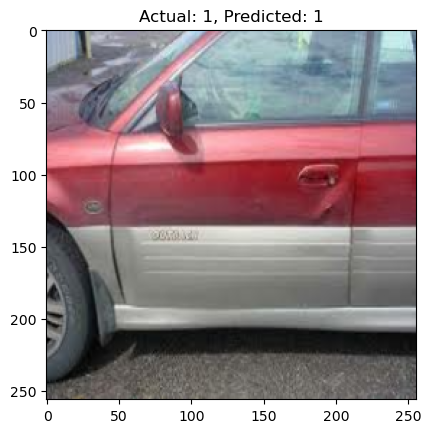

Actual: 1, Predicted: 1


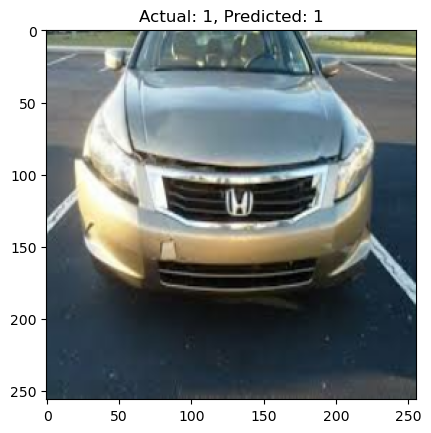

Actual: 0, Predicted: 0


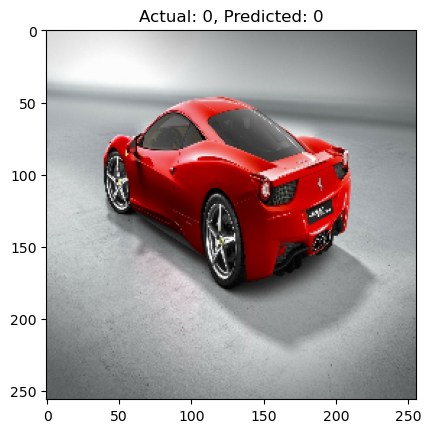

Actual: 0, Predicted: 0


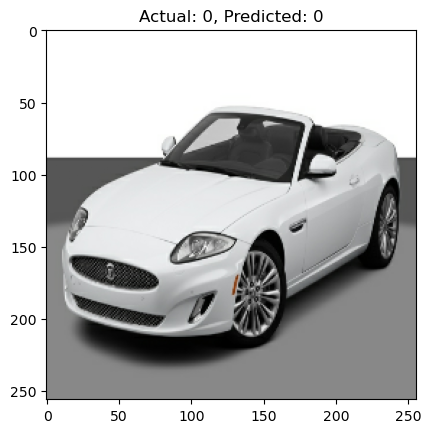

Actual: 0, Predicted: 0


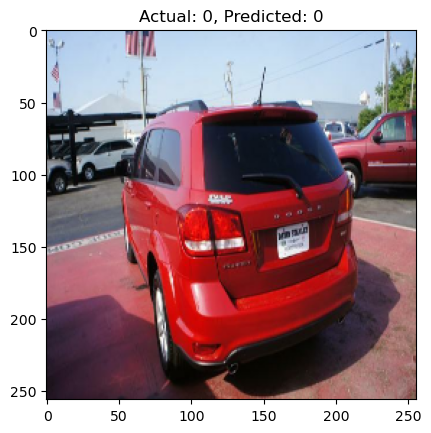

Actual: 0, Predicted: 0


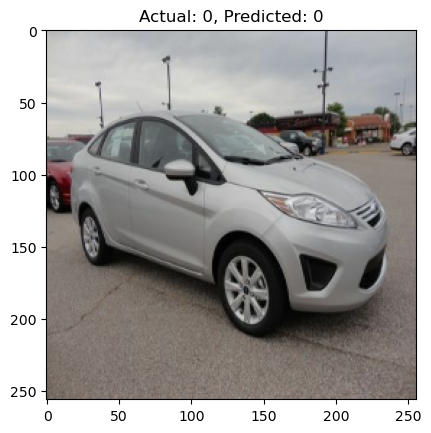

Actual: 0, Predicted: 0


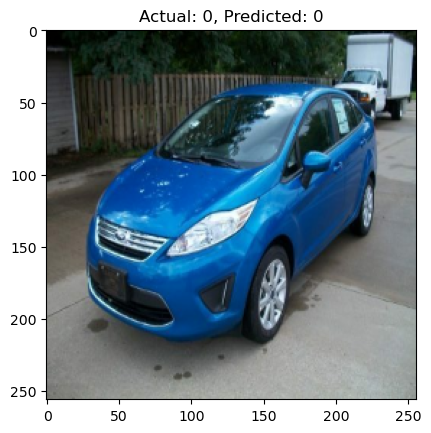

Actual: 1, Predicted: 1


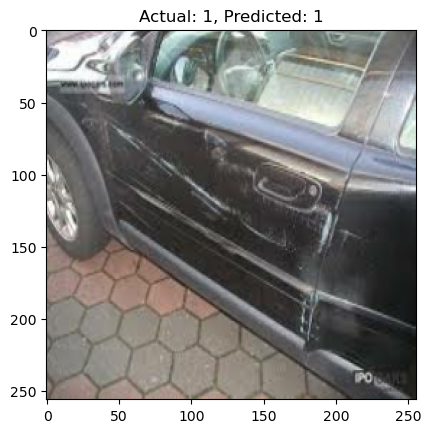

Actual: 0, Predicted: 0


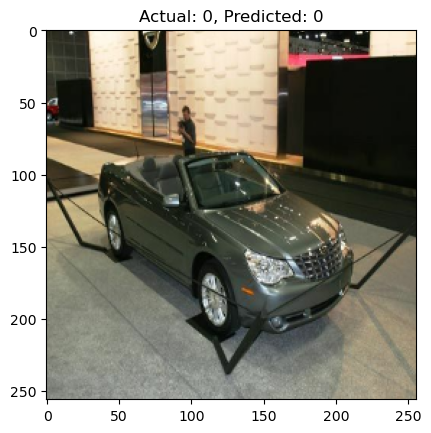

Actual: 1, Predicted: 1


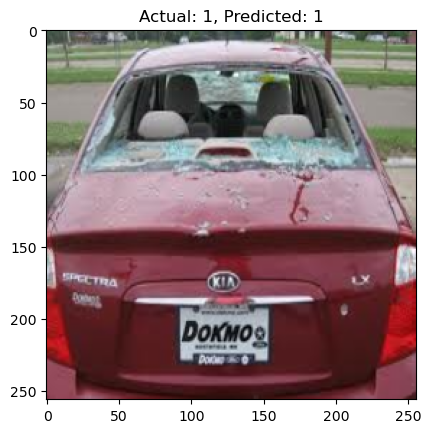

Actual: 0, Predicted: 0


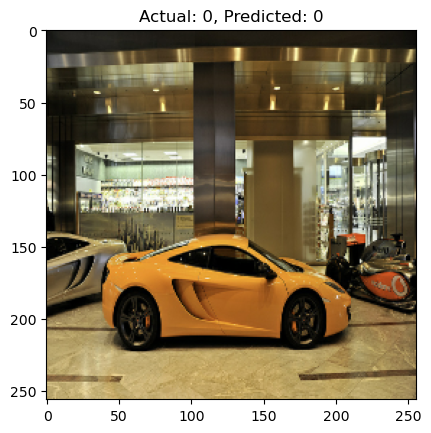

Actual: 1, Predicted: 1


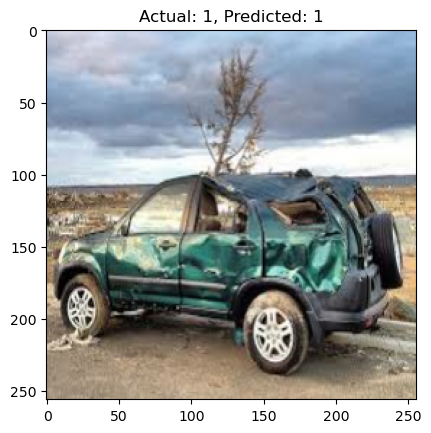

Actual: 1, Predicted: 1


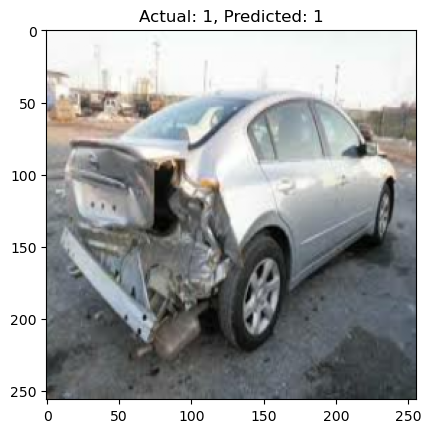

Actual: 0, Predicted: 0


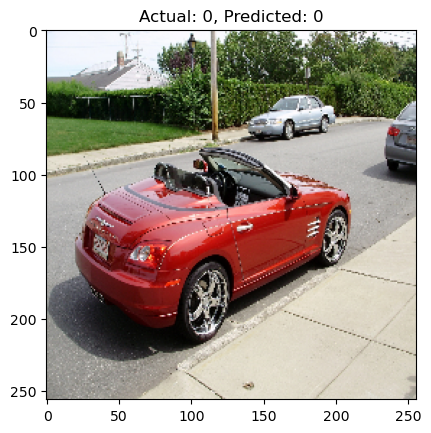

Actual: 1, Predicted: 1


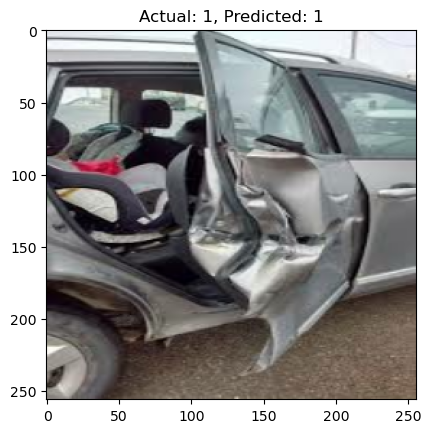

Actual: 1, Predicted: 1


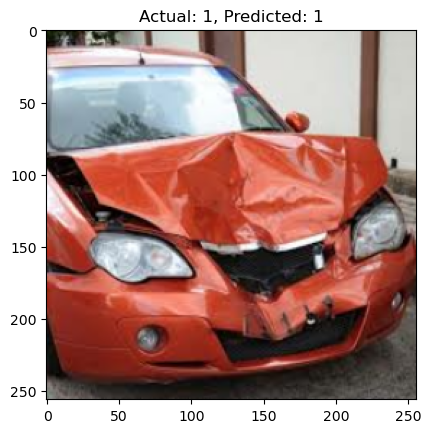

Actual: 1, Predicted: 1


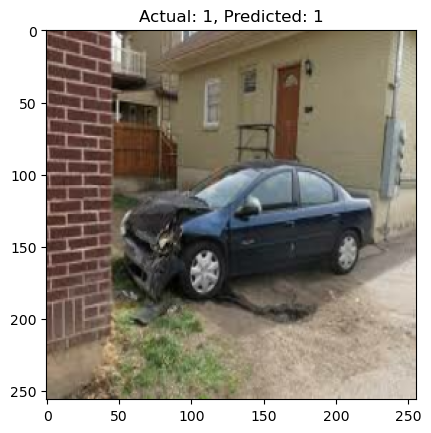

Actual: 1, Predicted: 1


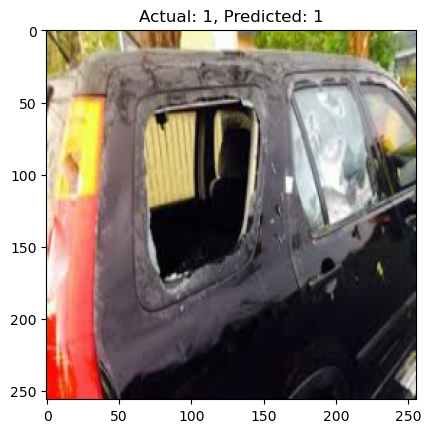

Actual: 1, Predicted: 1


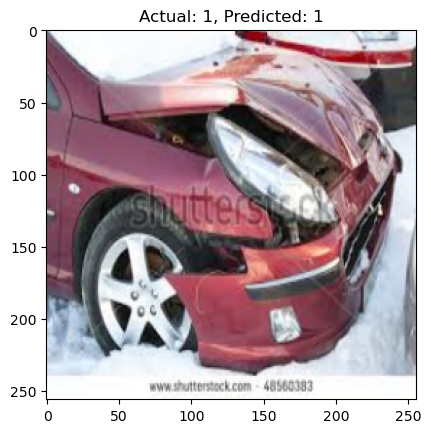

Actual: 0, Predicted: 0


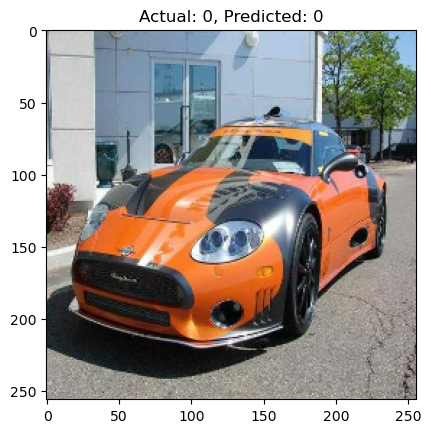

Actual: 0, Predicted: 0


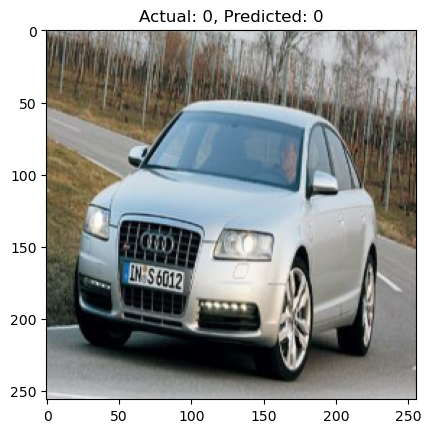

Actual: 1, Predicted: 1


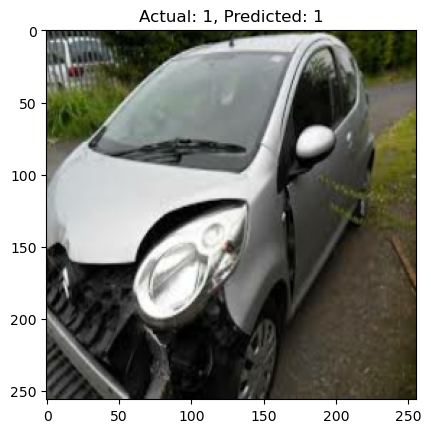

Actual: 0, Predicted: 0


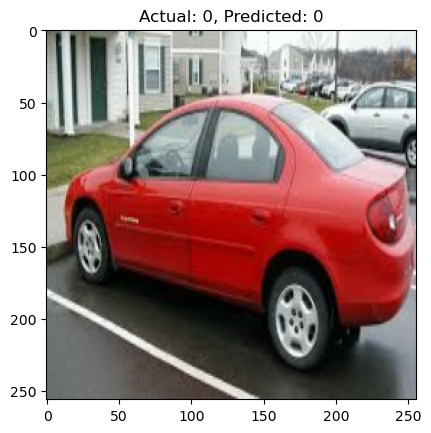

Actual: 0, Predicted: 0


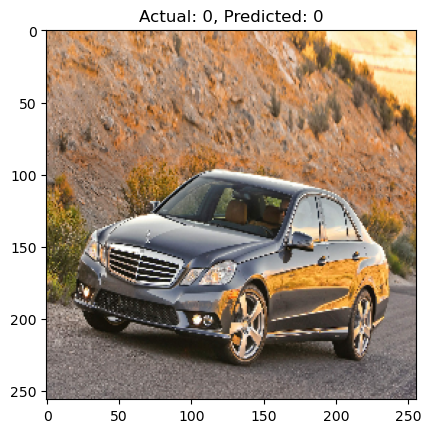

Actual: 1, Predicted: 1


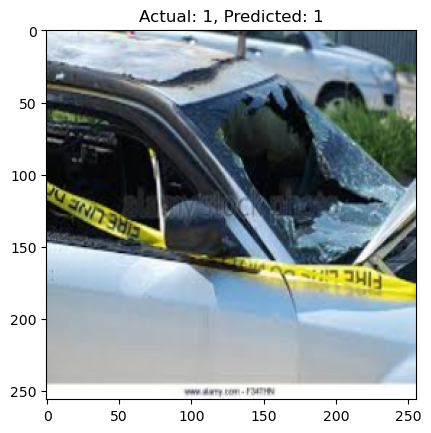

Actual: 1, Predicted: 1


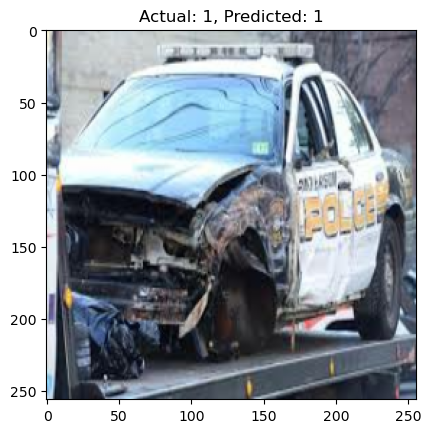

Actual: 0, Predicted: 0


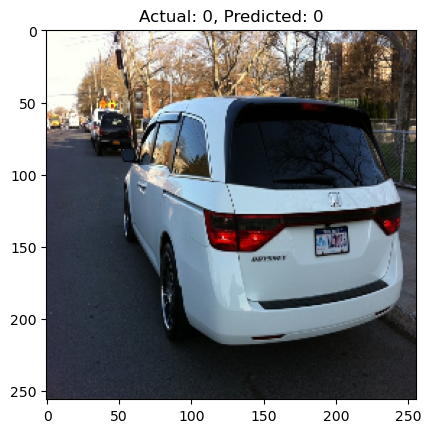

Actual: 0, Predicted: 0


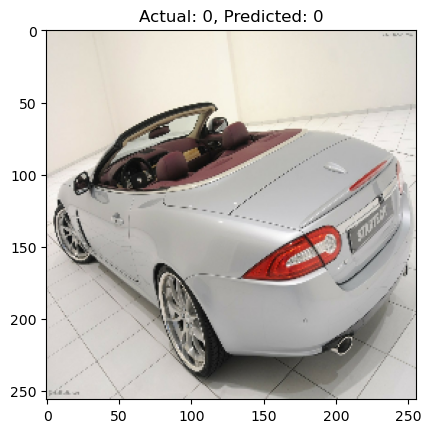

Actual: 1, Predicted: 1


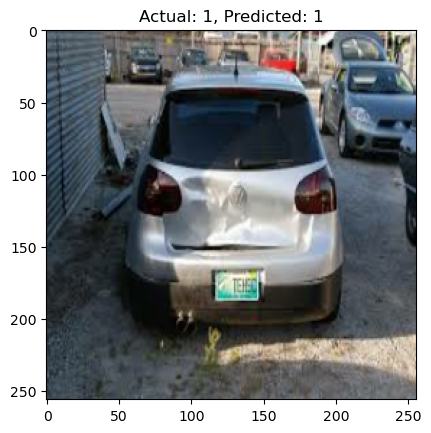

Actual: 0, Predicted: 0


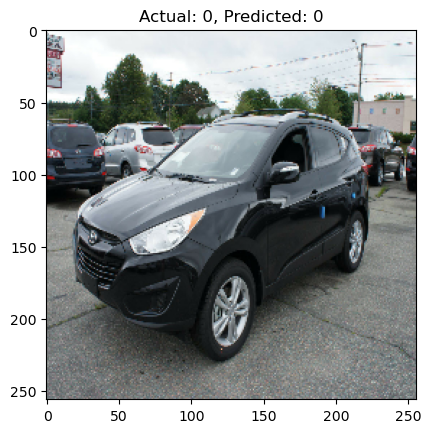

(32,) (32,)
1/1 [==============================] - 1s 1s/step
Actual: 0, Predicted: 0


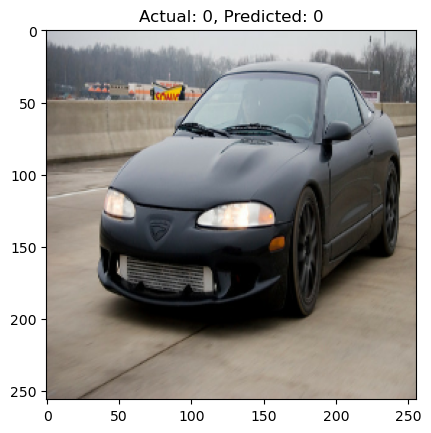

Actual: 1, Predicted: 1


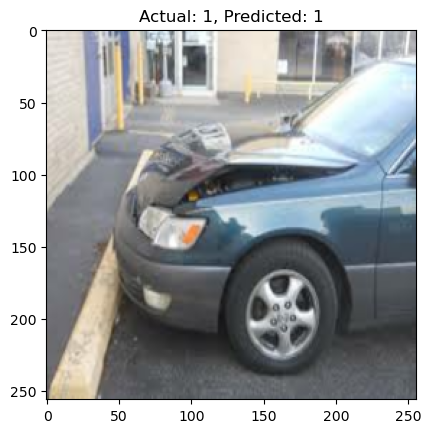

Actual: 0, Predicted: 1


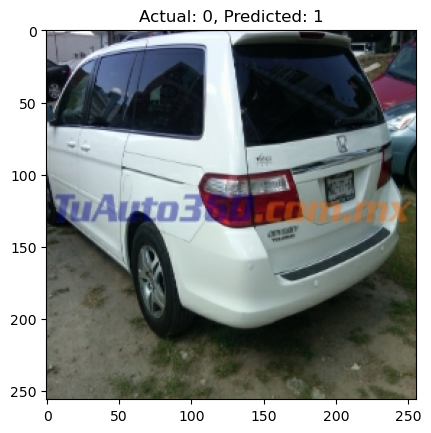

Actual: 1, Predicted: 1


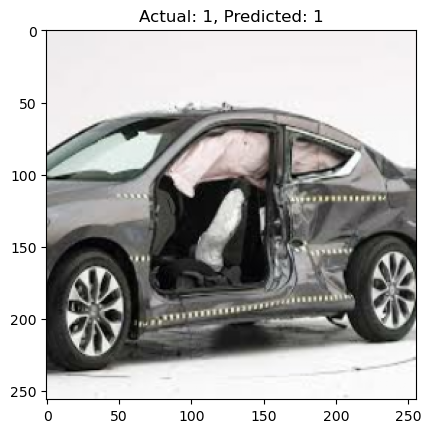

Actual: 0, Predicted: 0


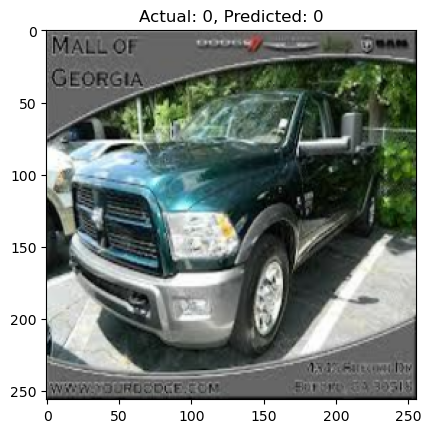

Actual: 0, Predicted: 0


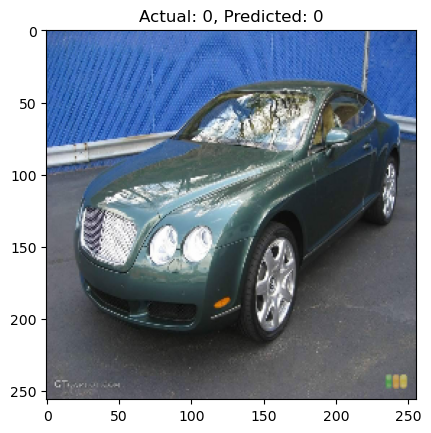

Actual: 1, Predicted: 1


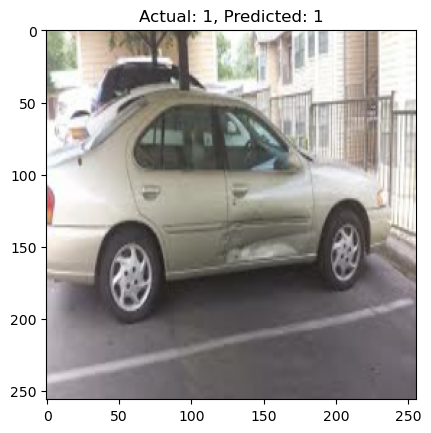

Actual: 0, Predicted: 0


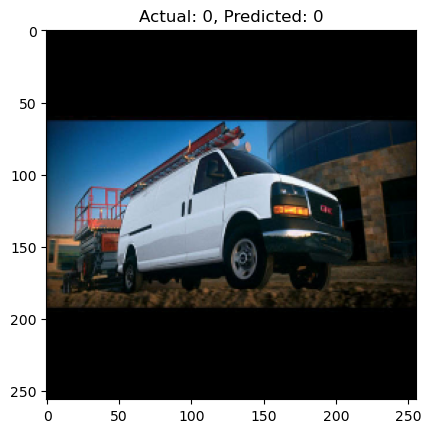

Actual: 1, Predicted: 0


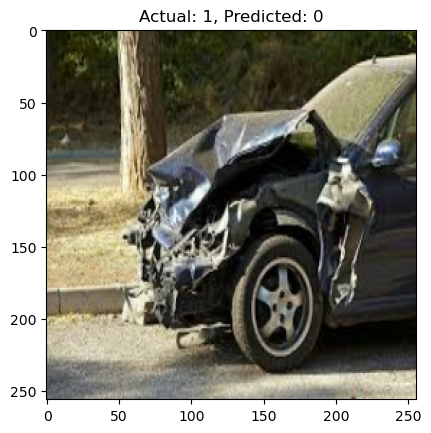

Actual: 1, Predicted: 1


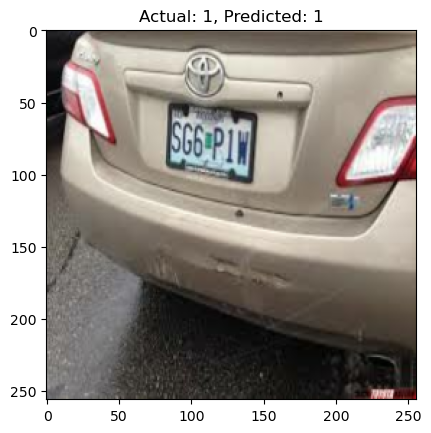

Actual: 0, Predicted: 0


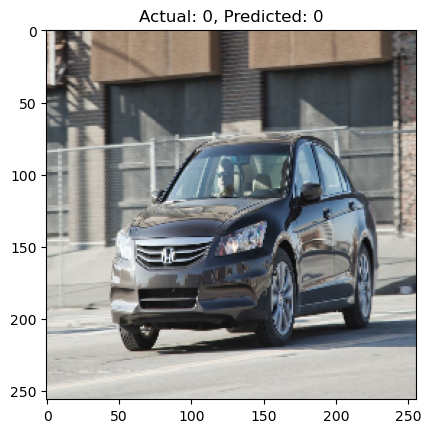

Actual: 0, Predicted: 0


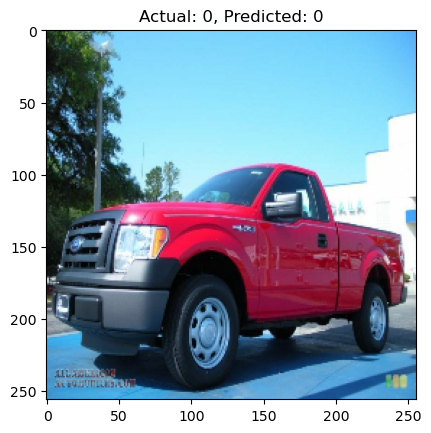

Actual: 0, Predicted: 1


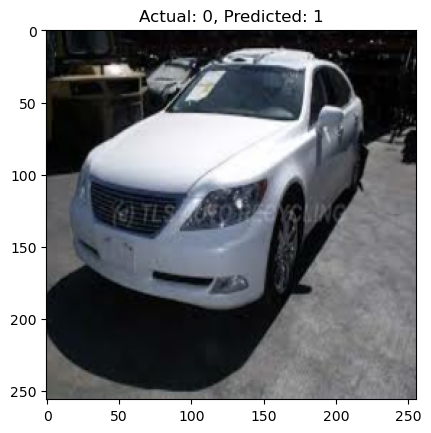

Actual: 0, Predicted: 0


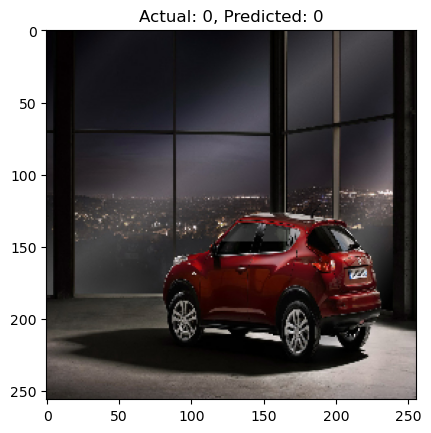

Actual: 0, Predicted: 0


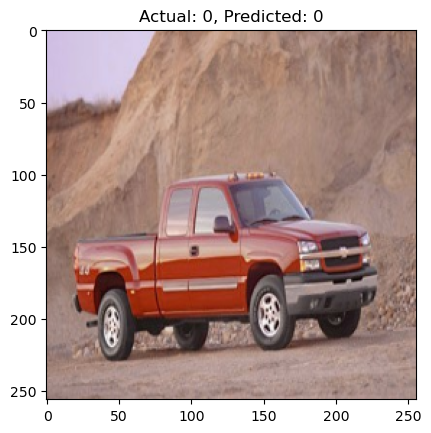

Actual: 0, Predicted: 0


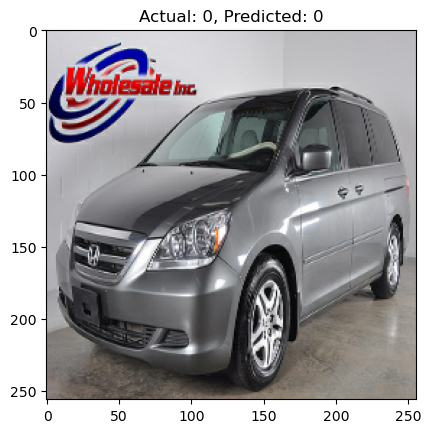

Actual: 0, Predicted: 0


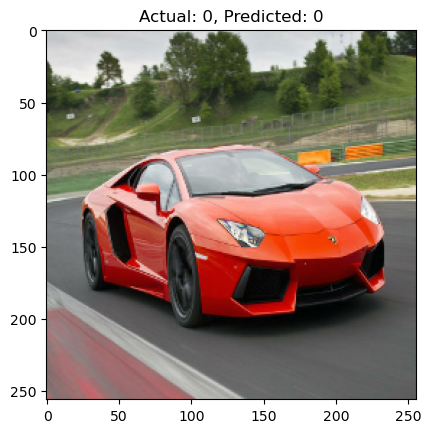

Actual: 0, Predicted: 0


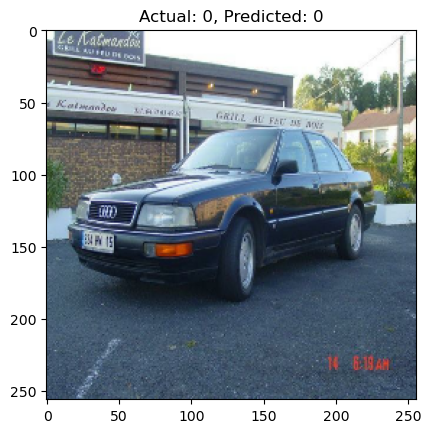

Actual: 0, Predicted: 0


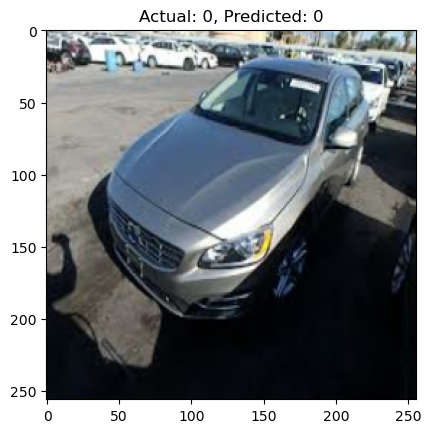

Actual: 1, Predicted: 1


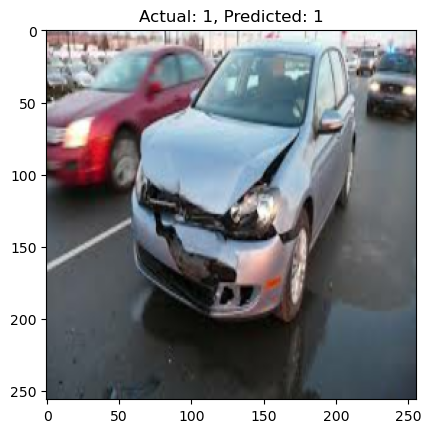

Actual: 0, Predicted: 0


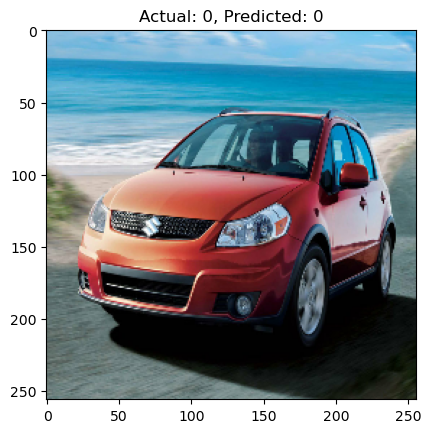

Actual: 1, Predicted: 0


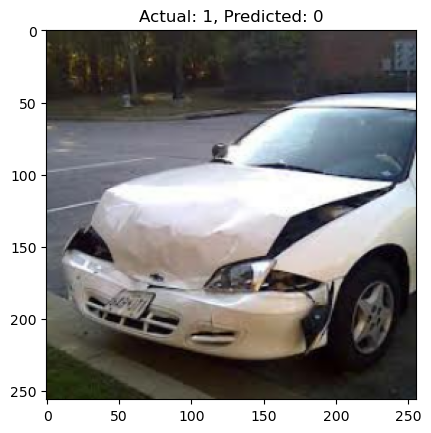

Actual: 1, Predicted: 1


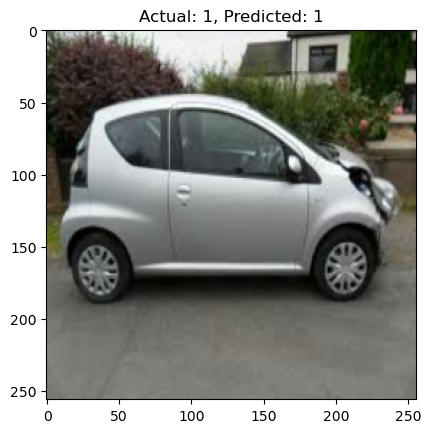

Actual: 0, Predicted: 0


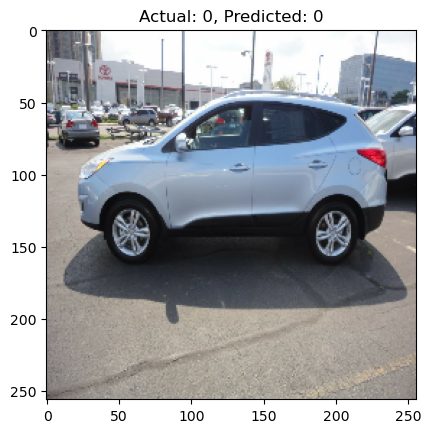

Actual: 1, Predicted: 1


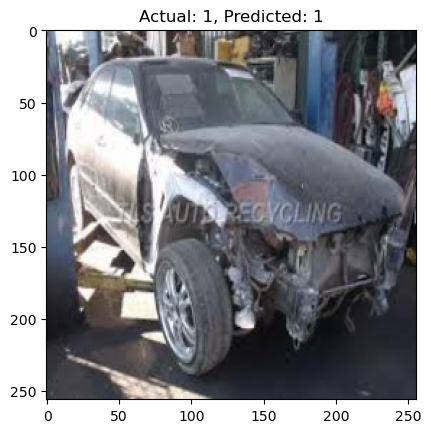

Actual: 1, Predicted: 1


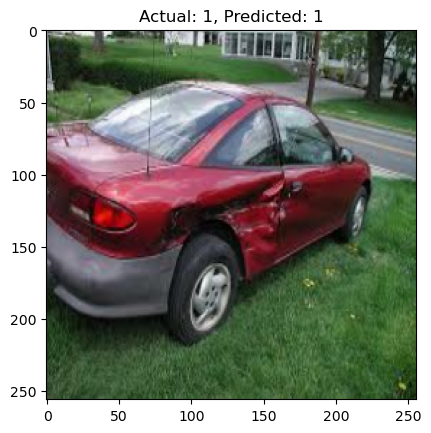

Actual: 0, Predicted: 0


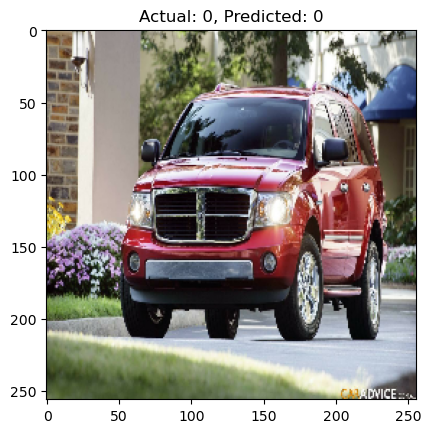

Actual: 0, Predicted: 0


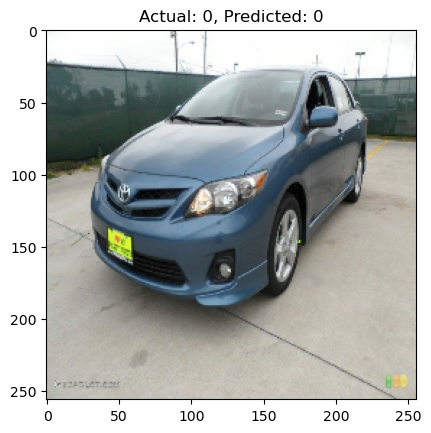

Actual: 1, Predicted: 1


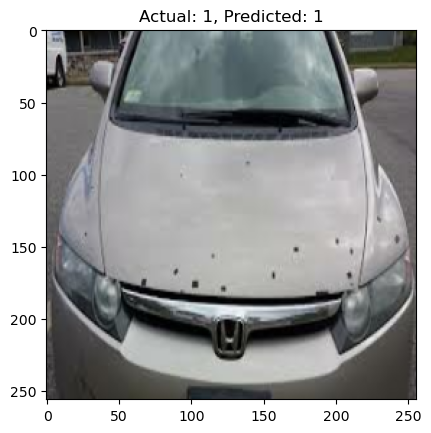

Actual: 0, Predicted: 0


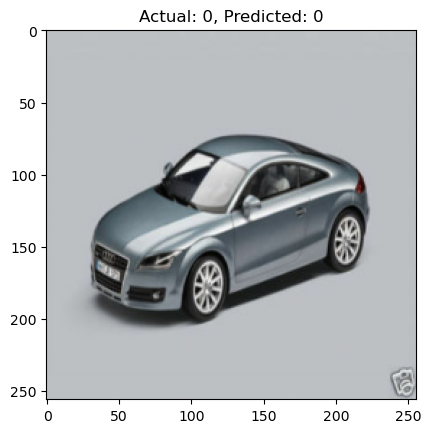

Actual: 0, Predicted: 0


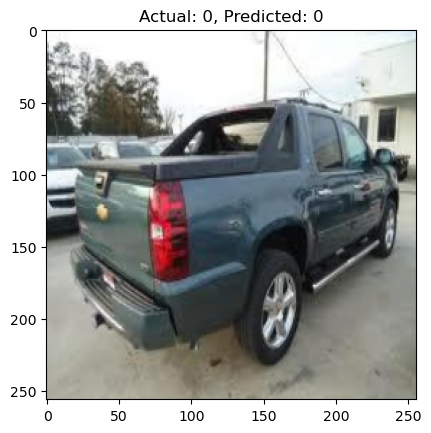

Actual: 1, Predicted: 1


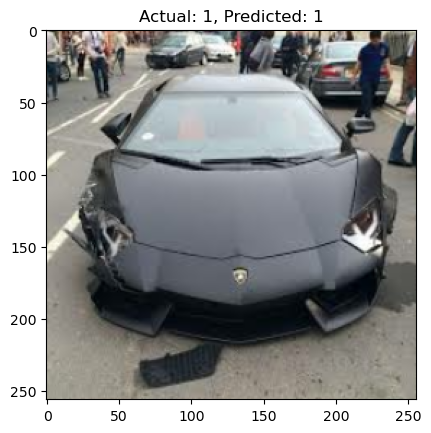

(32,) (32,)
1/1 [==============================] - 1s 993ms/step
Actual: 0, Predicted: 0


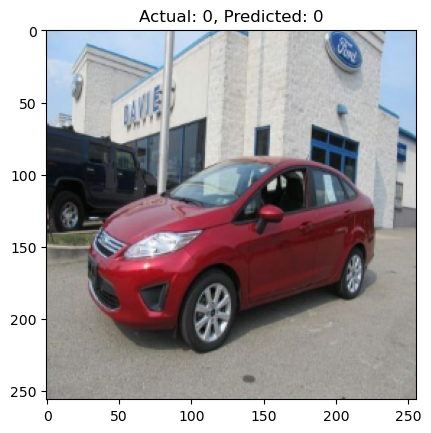

Actual: 1, Predicted: 1


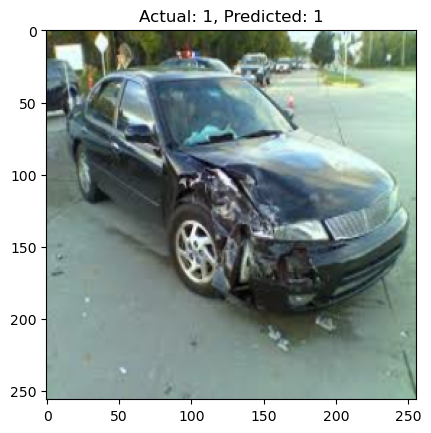

Actual: 1, Predicted: 1


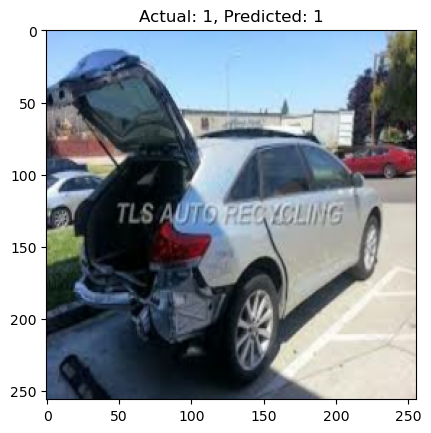

Actual: 1, Predicted: 1


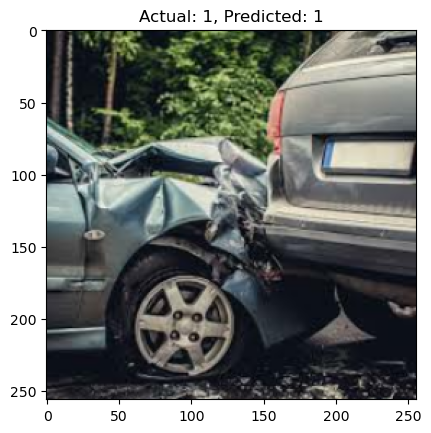

Actual: 1, Predicted: 1


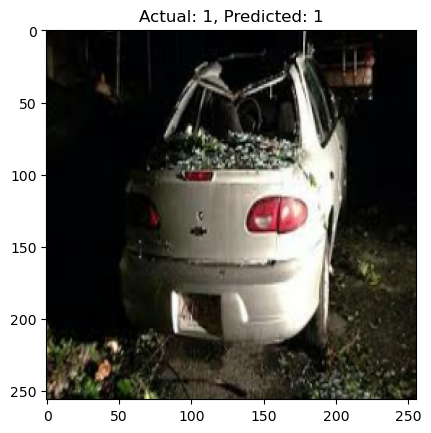

Actual: 0, Predicted: 0


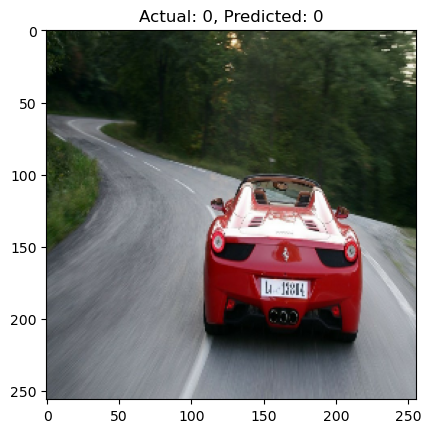

Actual: 1, Predicted: 1


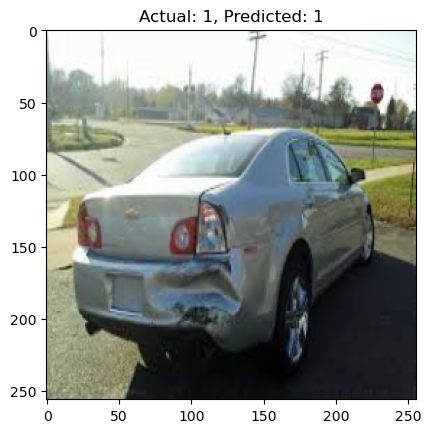

Actual: 1, Predicted: 1


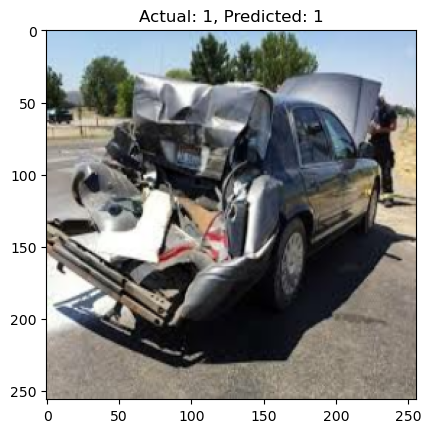

Actual: 0, Predicted: 0


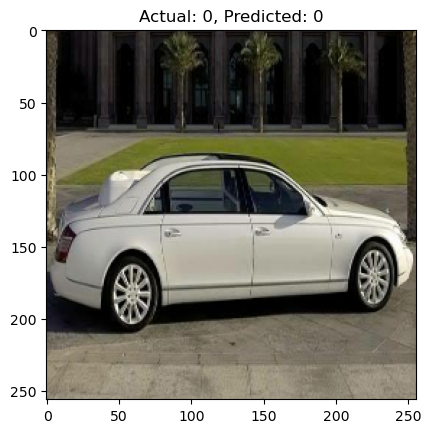

Actual: 0, Predicted: 0


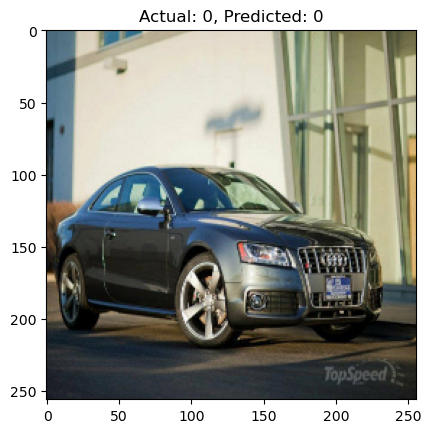

Actual: 1, Predicted: 1


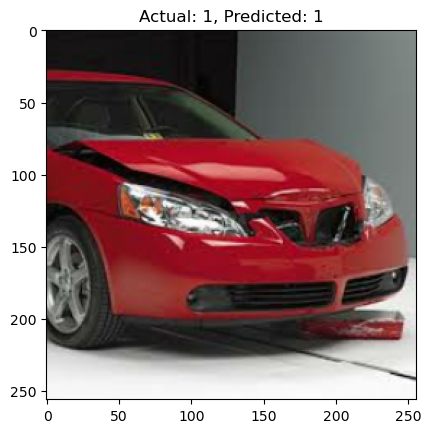

Actual: 0, Predicted: 1


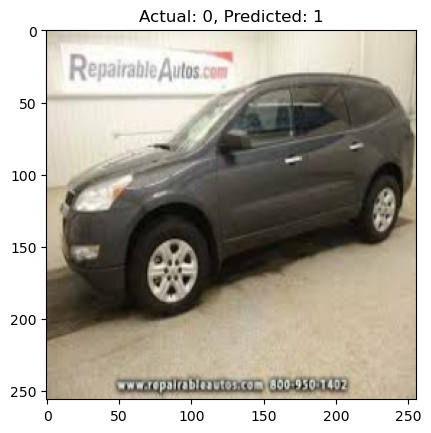

Actual: 1, Predicted: 1


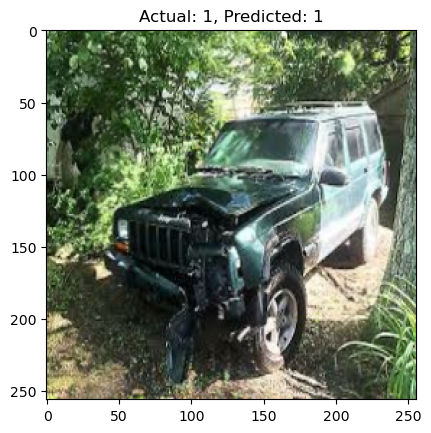

Actual: 0, Predicted: 0


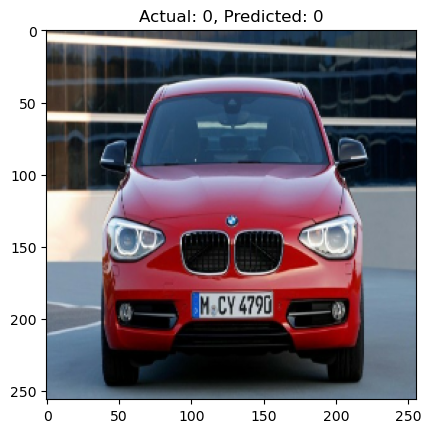

Actual: 1, Predicted: 1


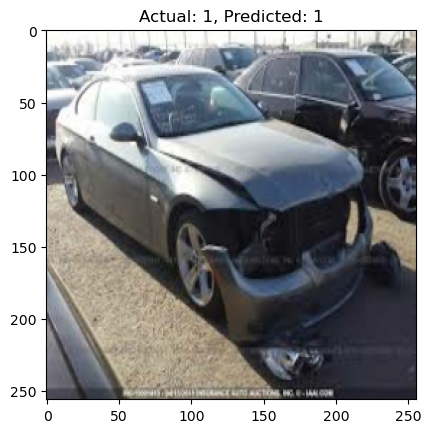

Actual: 1, Predicted: 1


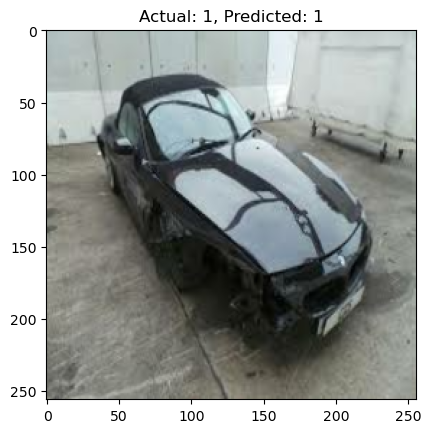

Actual: 1, Predicted: 1


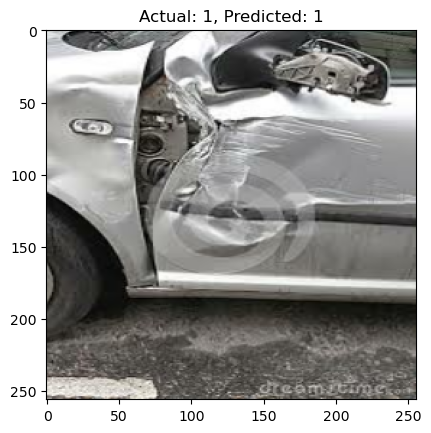

Actual: 0, Predicted: 1


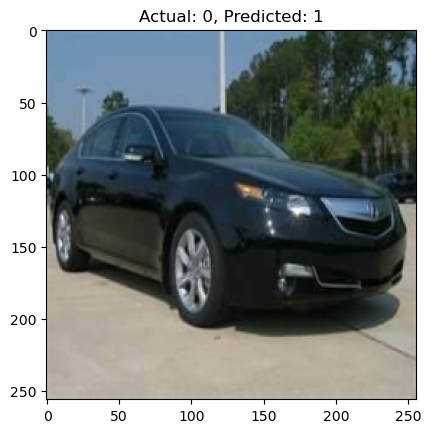

Actual: 0, Predicted: 0


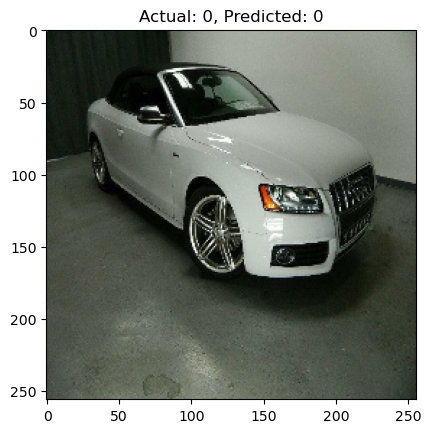

Actual: 0, Predicted: 0


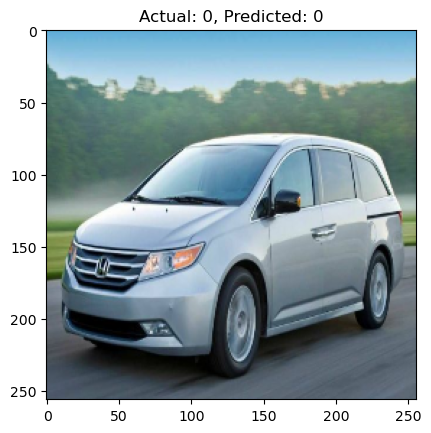

Actual: 1, Predicted: 1


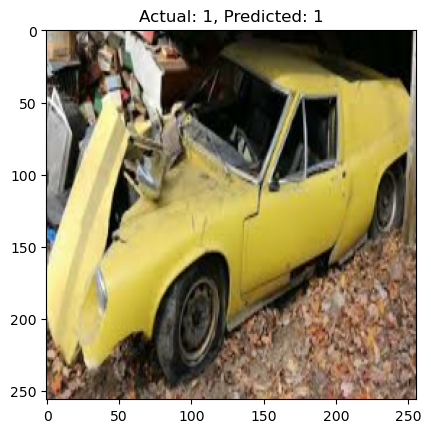

Actual: 1, Predicted: 1


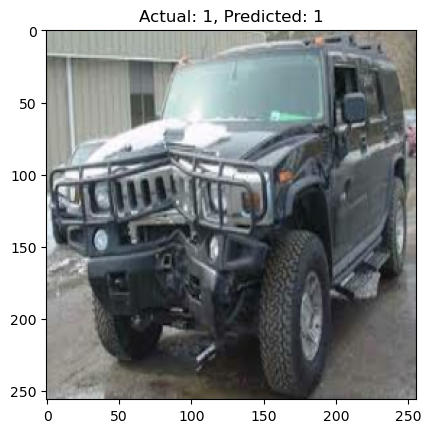

Actual: 1, Predicted: 1


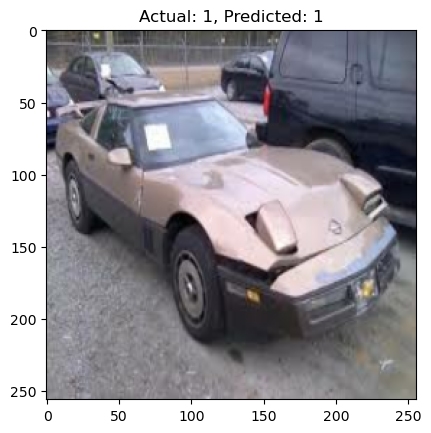

Actual: 1, Predicted: 1


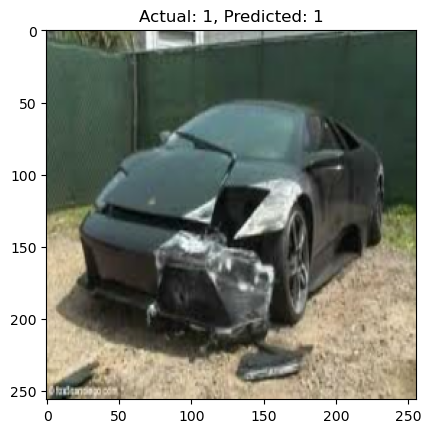

Actual: 0, Predicted: 0


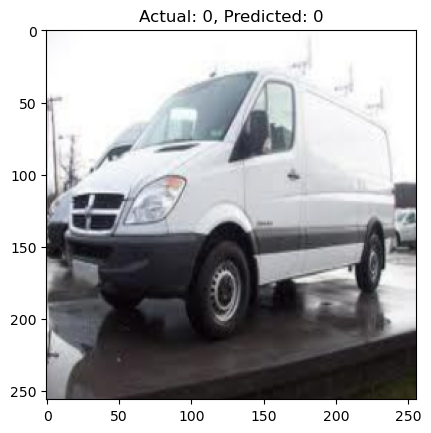

Actual: 0, Predicted: 0


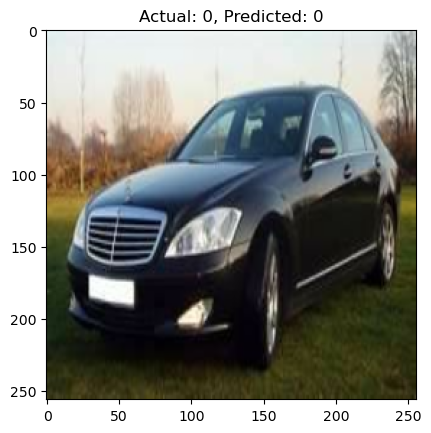

Actual: 1, Predicted: 1


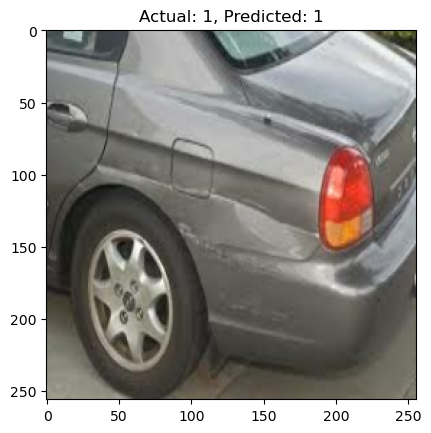

Actual: 0, Predicted: 0


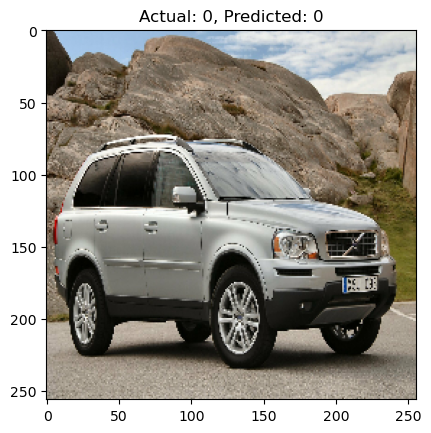

Actual: 0, Predicted: 0


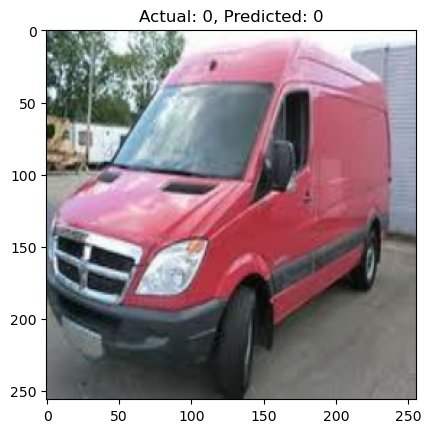

Actual: 1, Predicted: 0


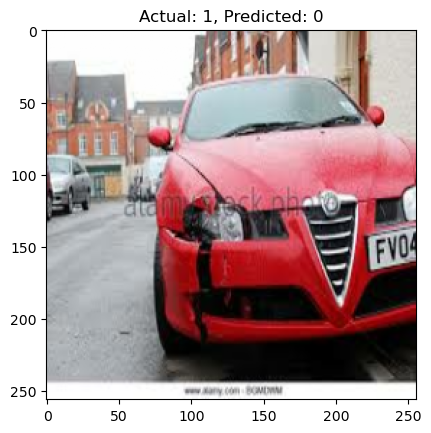

Actual: 0, Predicted: 0


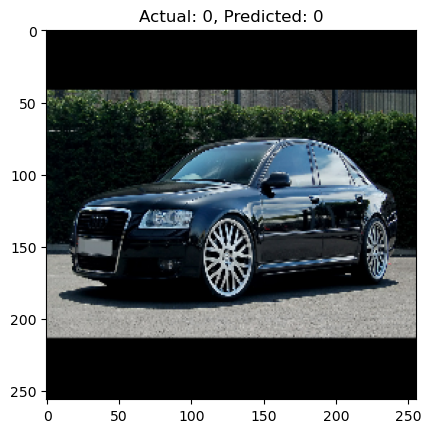

Actual: 1, Predicted: 1


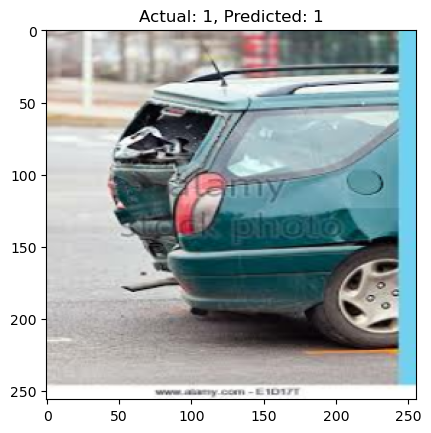

(32,) (32,)
1/1 [==============================] - 1s 1s/step
Actual: 0, Predicted: 1


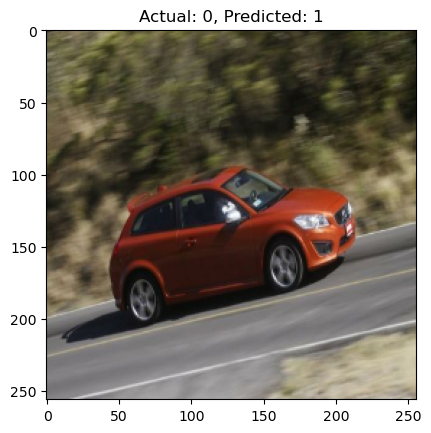

Actual: 0, Predicted: 0


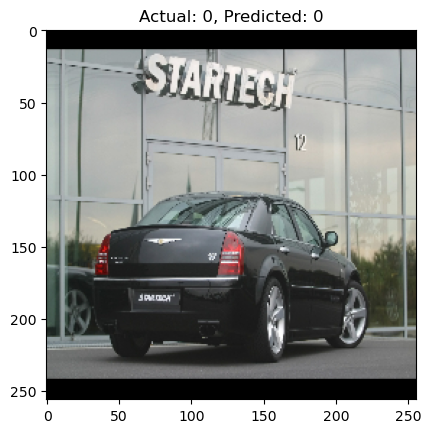

Actual: 0, Predicted: 0


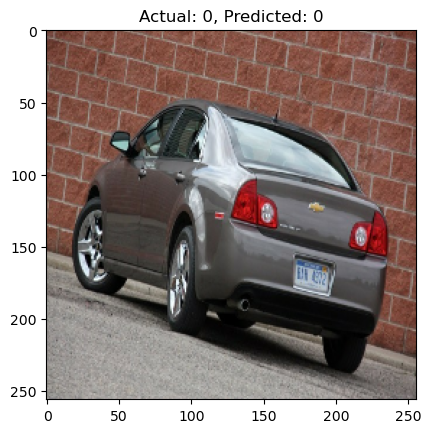

Actual: 0, Predicted: 0


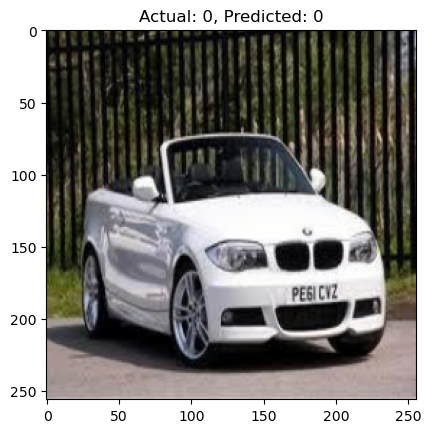

Actual: 1, Predicted: 1


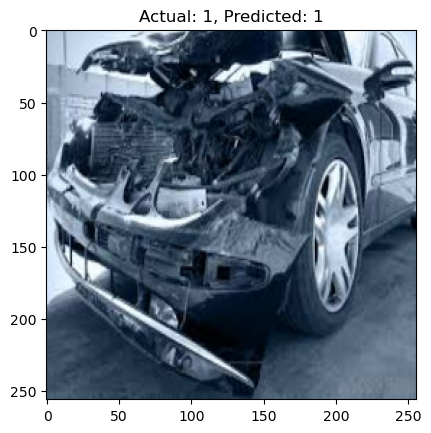

Actual: 1, Predicted: 1


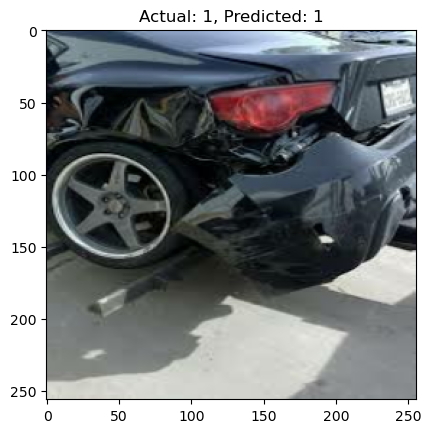

Actual: 1, Predicted: 1


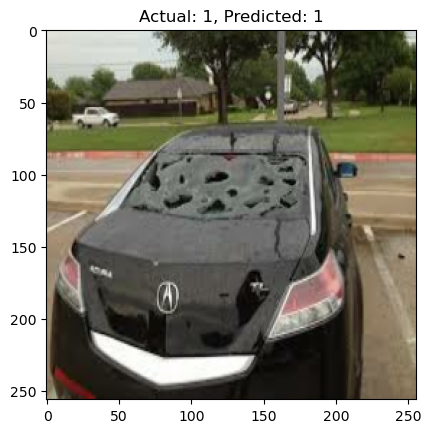

Actual: 0, Predicted: 0


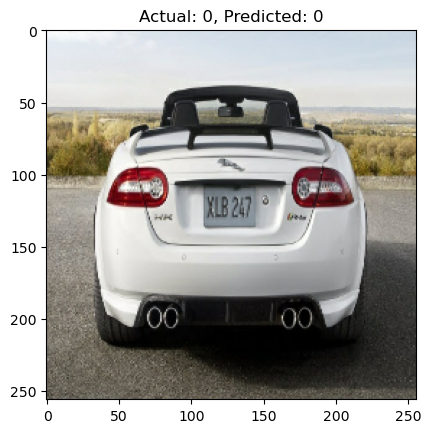

Actual: 1, Predicted: 1


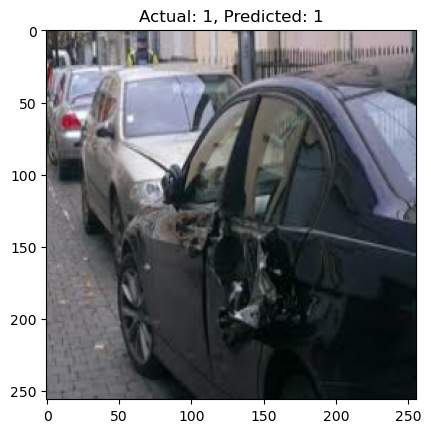

Actual: 1, Predicted: 0


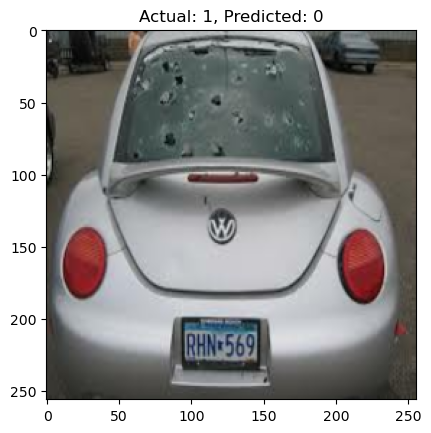

Actual: 0, Predicted: 0


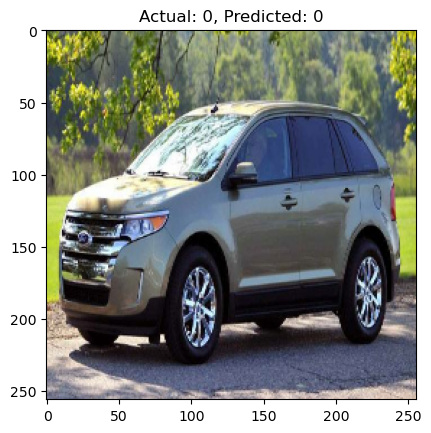

Actual: 0, Predicted: 0


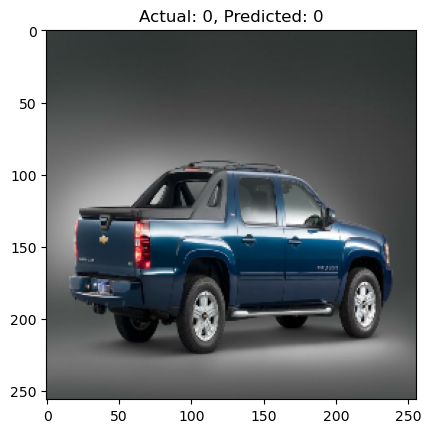

Actual: 0, Predicted: 0


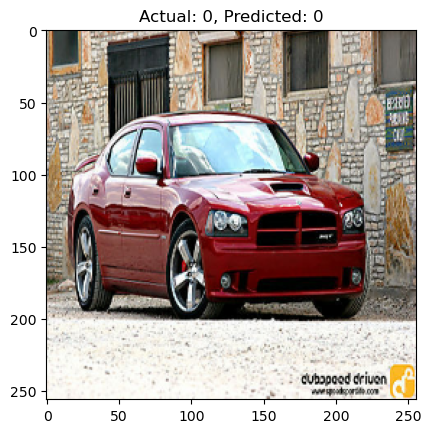

Actual: 0, Predicted: 0


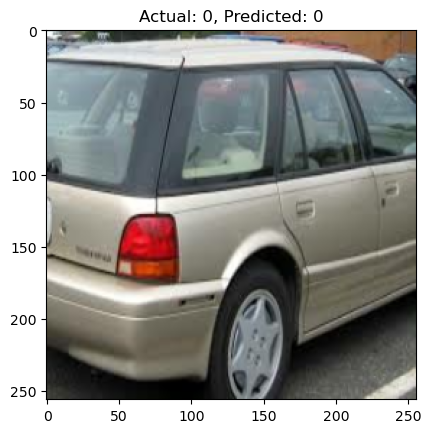

Actual: 1, Predicted: 1


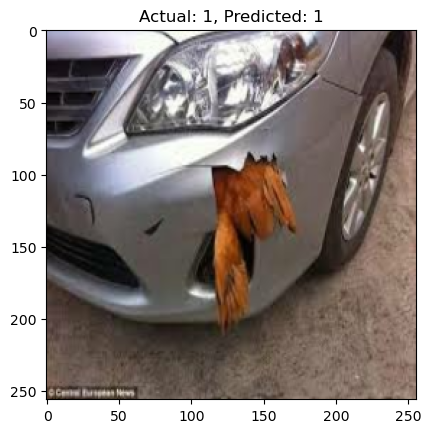

Actual: 1, Predicted: 1


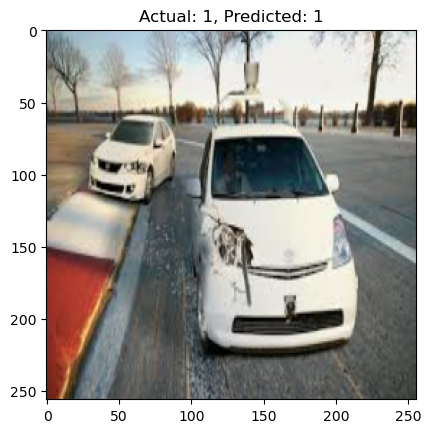

Actual: 0, Predicted: 0


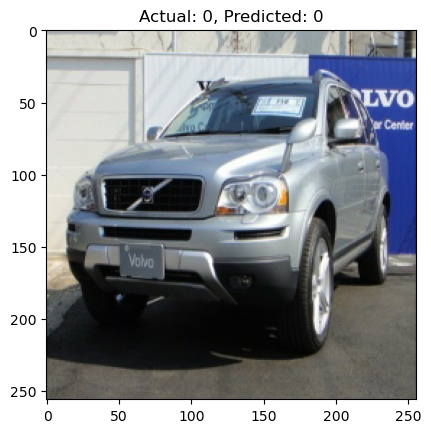

Actual: 1, Predicted: 1


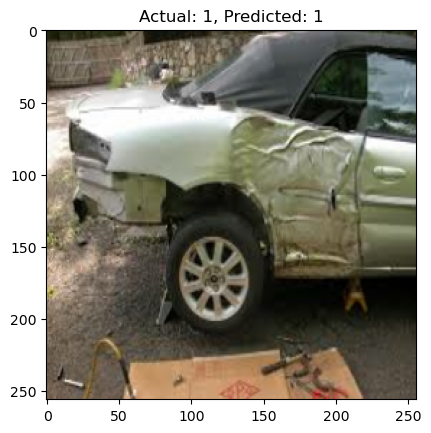

Actual: 0, Predicted: 0


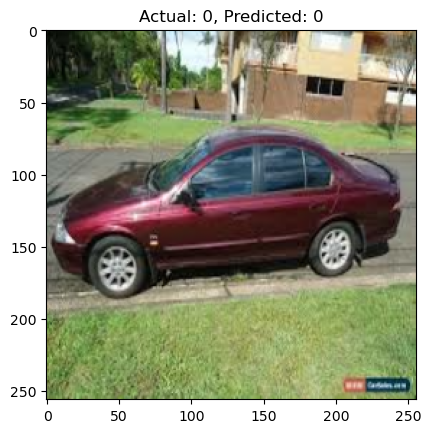

Actual: 0, Predicted: 1


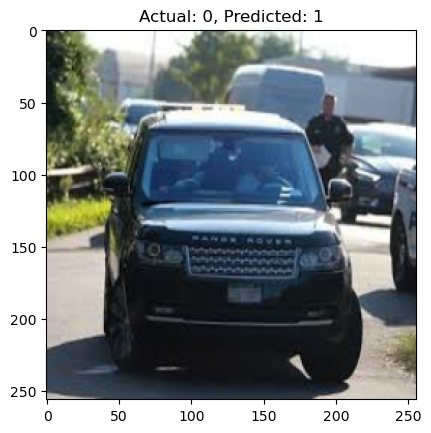

Actual: 1, Predicted: 1


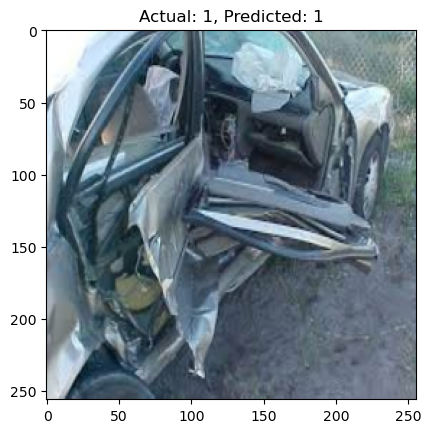

Actual: 0, Predicted: 0


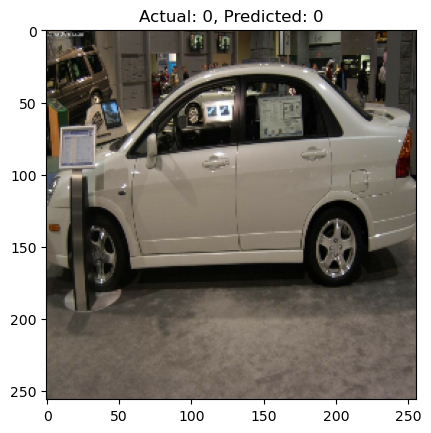

Actual: 0, Predicted: 0


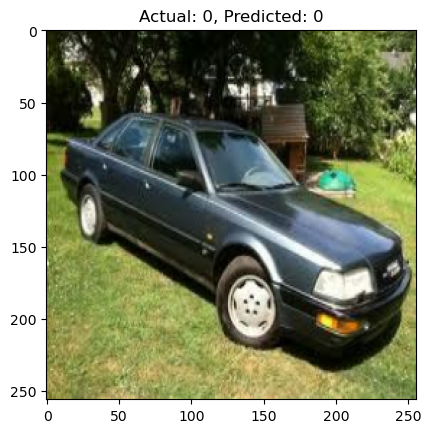

Actual: 0, Predicted: 0


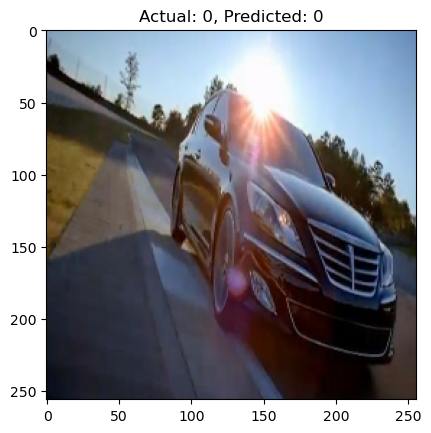

Actual: 1, Predicted: 1


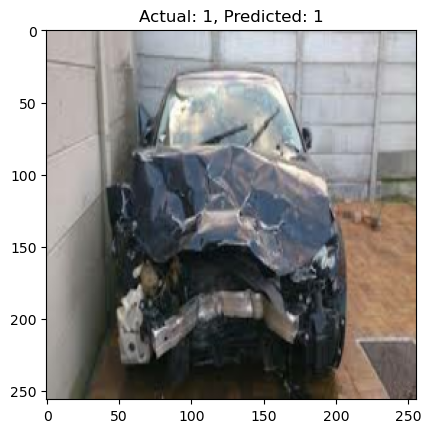

Actual: 1, Predicted: 1


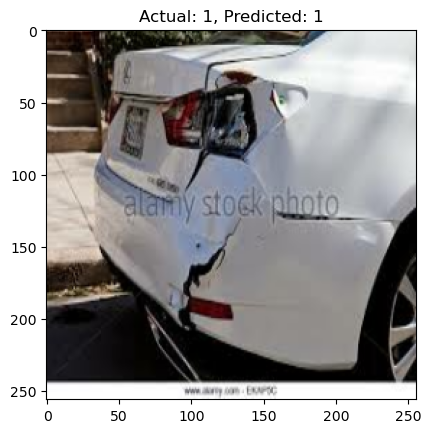

Actual: 0, Predicted: 1


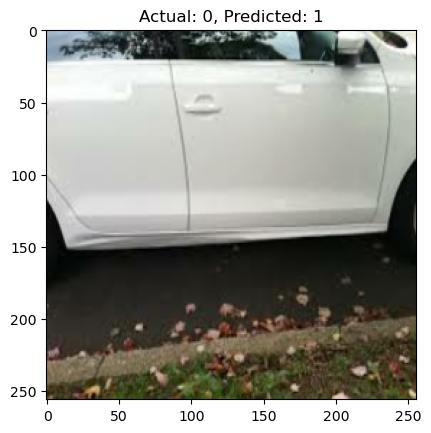

Actual: 0, Predicted: 0


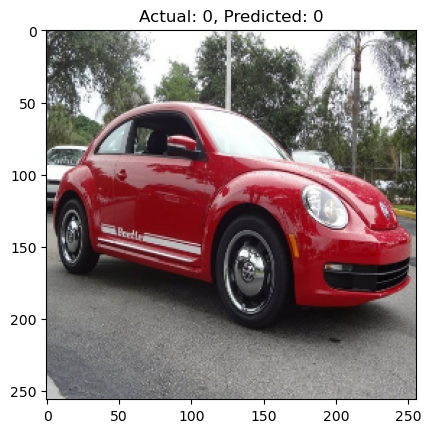

Actual: 1, Predicted: 1


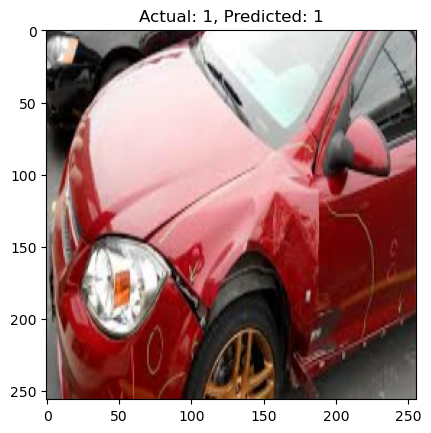

Actual: 1, Predicted: 1


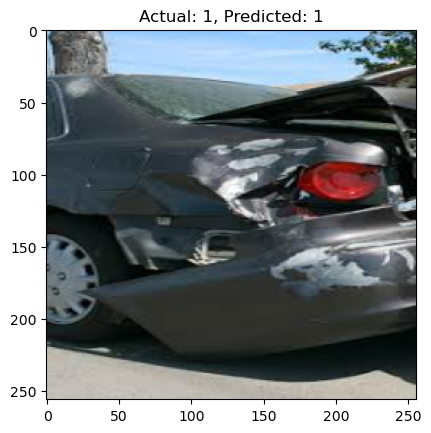

Actual: 0, Predicted: 0


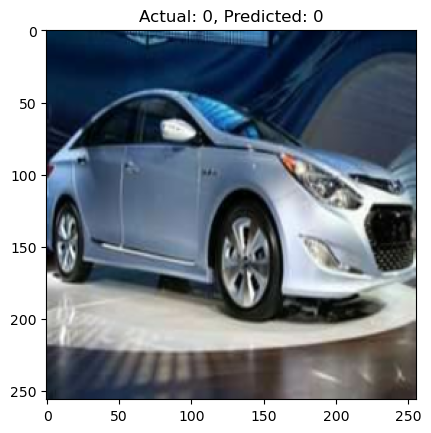

Actual: 1, Predicted: 1


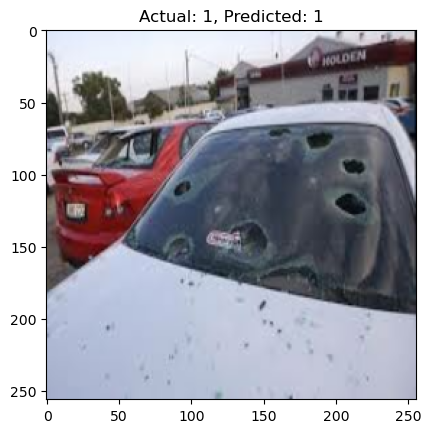

(32,) (32,)
1/1 [==============================] - 1s 966ms/step
Actual: 0, Predicted: 1


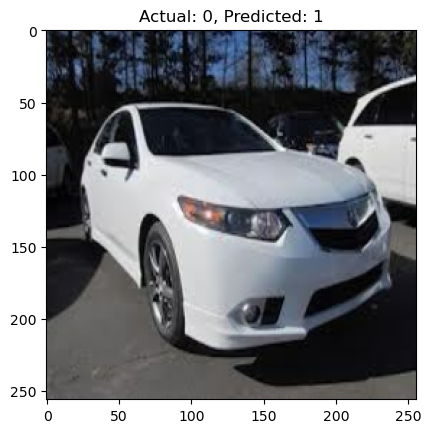

Actual: 1, Predicted: 1


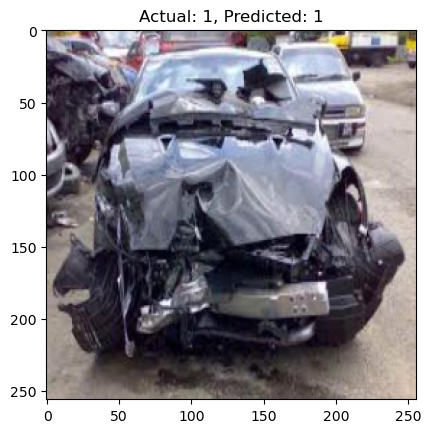

Actual: 1, Predicted: 1


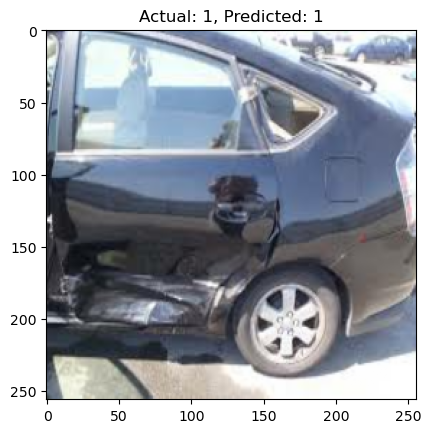

Actual: 0, Predicted: 0


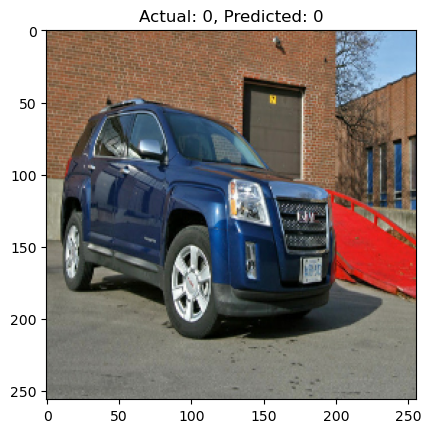

Actual: 0, Predicted: 0


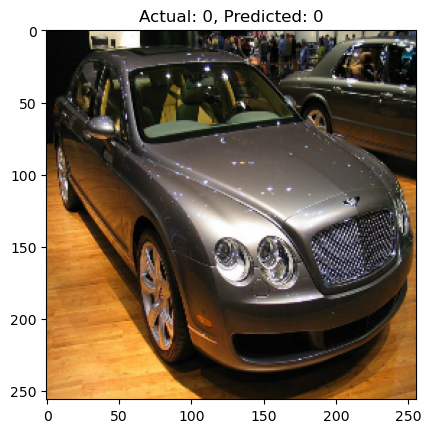

Actual: 1, Predicted: 1


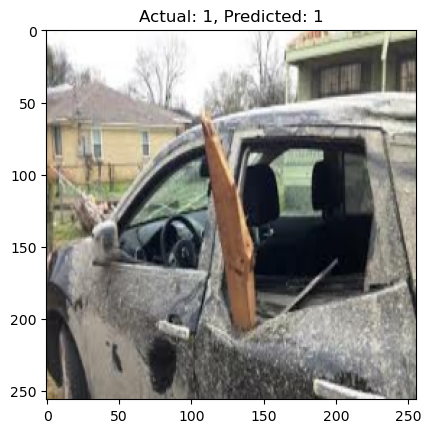

Actual: 0, Predicted: 0


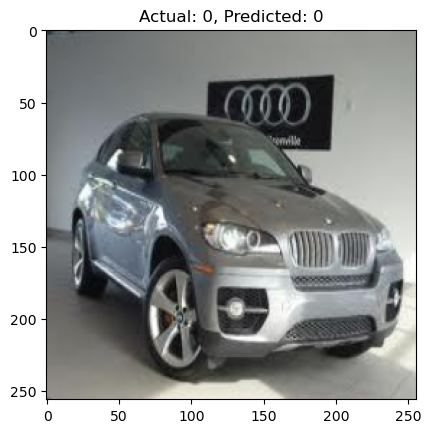

Actual: 1, Predicted: 1


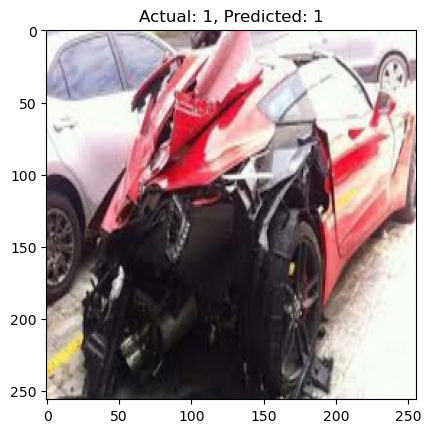

Actual: 1, Predicted: 1


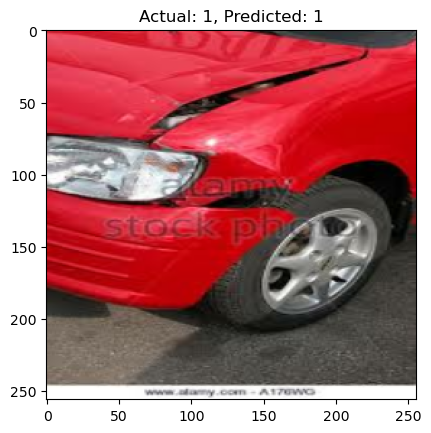

Actual: 0, Predicted: 0


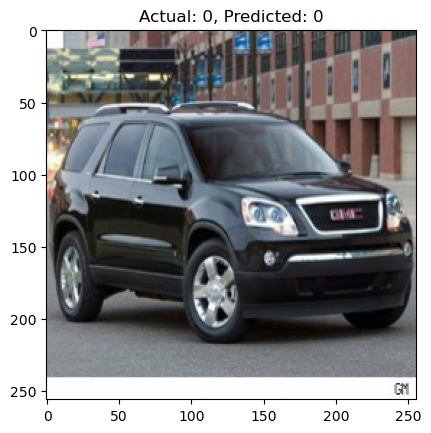

Actual: 0, Predicted: 0


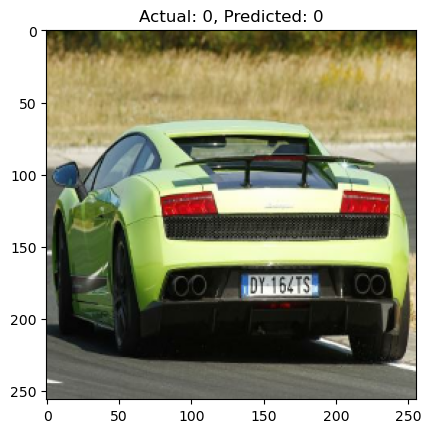

Actual: 1, Predicted: 1


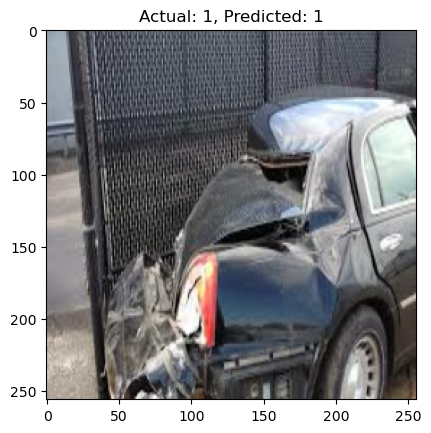

Actual: 0, Predicted: 1


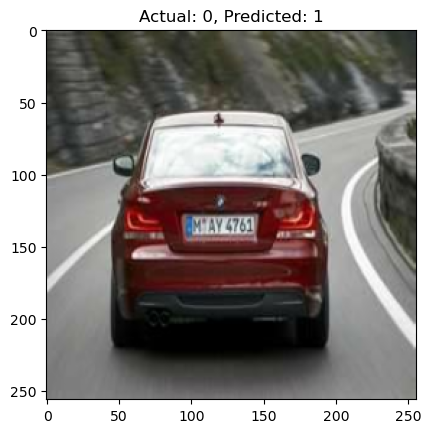

Actual: 1, Predicted: 1


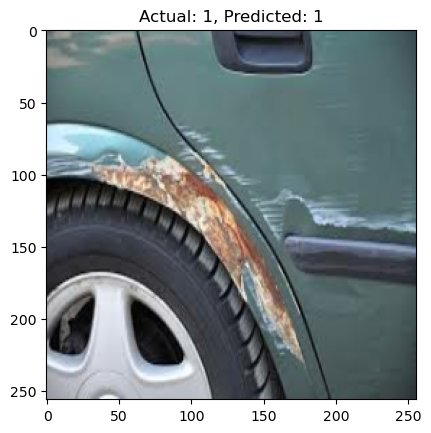

Actual: 1, Predicted: 1


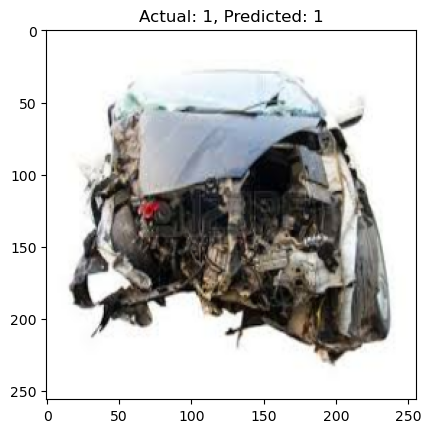

Actual: 0, Predicted: 0


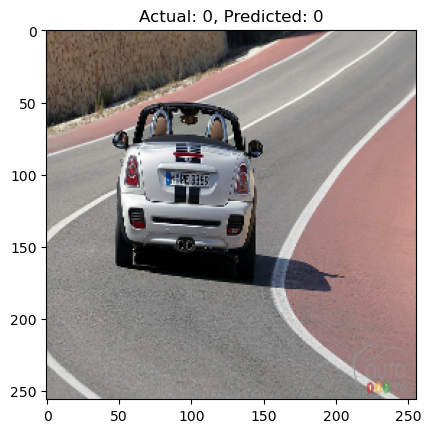

Actual: 0, Predicted: 0


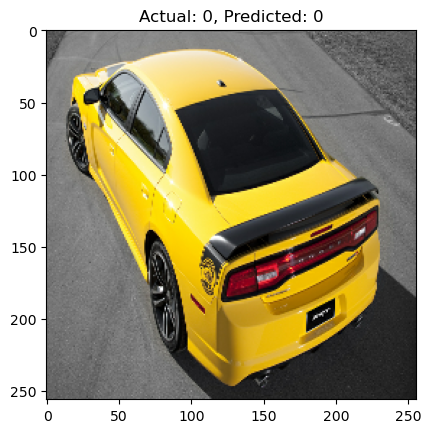

Actual: 1, Predicted: 1


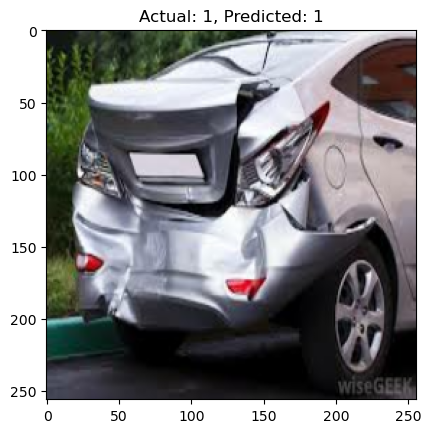

Actual: 1, Predicted: 1


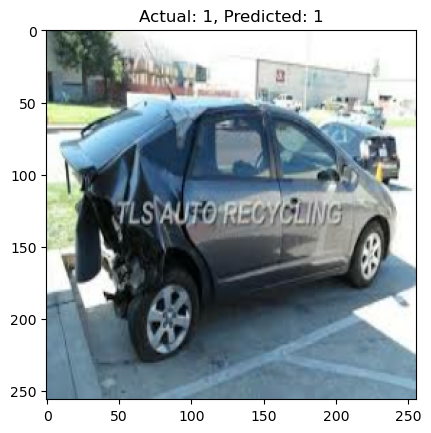

Actual: 0, Predicted: 1


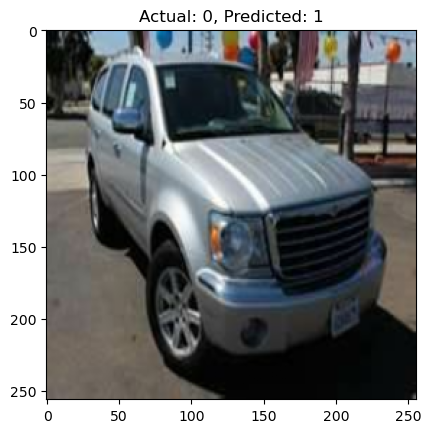

Actual: 1, Predicted: 1


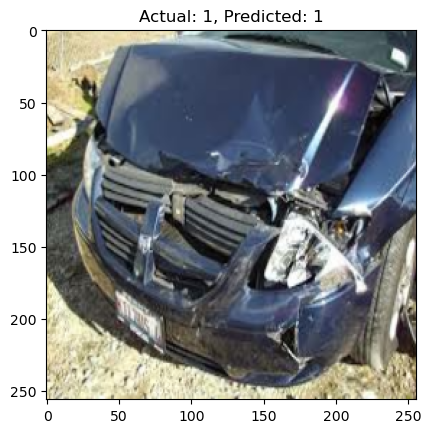

(21,) (21,)


In [129]:


pre.reset_states()
re.reset_states()
acc.reset_states()

for batch in test.as_numpy_iterator():
    X, y = batch
    yhat = model.predict(X)

    # Get predicted classes
    yhat_classes = np.argmax(yhat, axis=1)

    for i in range(len(y)):
        actual = y[i]
        predicted = yhat_classes[i]

        # Print actual and predicted labels
        print(f"Actual: {actual}, Predicted: {predicted}")

        #Display the image
        plt.imshow(X[i])
        plt.title(f"Actual: {actual}, Predicted: {predicted}")
        plt.show()
    print(y.shape,yhat_classes.shape)
    # Assuming 'pre', 're', 'acc' are instances of metrics classes
    pre.update_state(y, yhat_classes)
    re.update_state(y, yhat_classes)
    acc.update_state(y, yhat_classes)




In [ ]:
pre.reset_states()
re.reset_states()
acc.reset_states()

for batch in test.as_numpy_iterator():
    X, y = batch
    yhat = model.predict(X)

    # Get predicted classes
    yhat_classes = np.argmax(yhat, axis=1)

    # One-hot encode the labels
    y_one_hot = tf.keras.utils.to_categorical(y, num_classes=num_classes)

    for i in range(len(y)):
        actual = y_one_hot[i]
        predicted = tf.one_hot(yhat_classes[i], depth=num_classes)

        # Print actual and predicted labels
        print(f"Actual: {actual}, Predicted: {predicted}")

        # Display the image
        # plt.imshow(X[i])
        # plt.title(f"Actual: {actual}, Predicted: {predicted}")
        # plt.show()

    # Assuming 'pre', 're', 'acc' are instances of metrics classes
    pre.update_state(y_one_hot, yhat)
    re.update_state(y_one_hot, yhat)
    acc.update_state(y_one_hot, yhat)

pre_result = pre.result().numpy()
re_result = re.result().numpy()
acc_result = acc.result().numpy()

print(f'Precision: {pre_result}, Recall: {re_result}, Accuracy: {acc_result}')


In [123]:
print(f"Precision:{pre.result().numpy()}, Recall:{re.result().numpy()}, Accuracy:{acc.result().numpy()}")

Precision:0.8513513803482056, Recall:0.8999999761581421, Accuracy:0.6000000238418579


Test

In [ ]:
import cv2

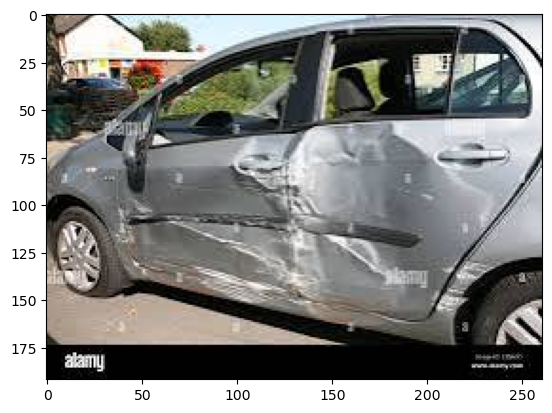

In [124]:
img=cv2.imread('test_img.jpg')
plt.imshow(cv2.cvtColor(img,cv2.COLOR_BGR2RGB))
plt.show()

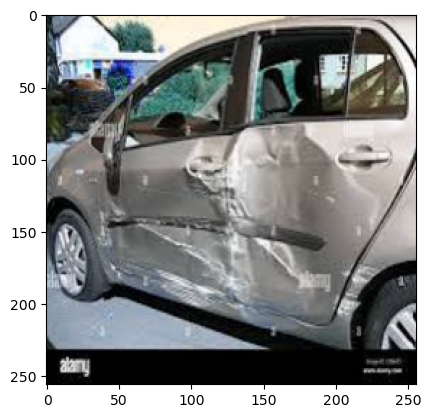

In [125]:
resize=tf.image.resize(img,(256,256))
plt.imshow(resize.numpy().astype(int))
plt.show()

In [126]:
yhat=model.predict(np.expand_dims(resize/255,0))

1/1 [==============================] - 0s 93ms/step


In [127]:
predicted_class = np.argmax(yhat)
print(f'Predicted Class: {predicted_class}')

Predicted Class: 1


In [ ]:
yhat